# Personal Information
Name: **Julian El-Fasih**

StudentID: **11302380**

Email: [**julian.el-fasih@student.uva.nl**](youremail@student.uva.nl)

Submitted on: **19-03-2023**

# Data Context

**Deformation Data**\
The dataset regarding the deformation of the quay walls in mm in x-, y-, and z-direction comprises tacheometry results obtained by the municipality of Amsterdam. Tacheometry entails repeated measurements of the coordinates of a measuring bolt in a wall. This way, the movement of the wall can be registrated.

**Soil Data**\
The soil data consist of the results of a Bore research and a CPT research. This data is provided by the BROloket. The bore research is done by taking samples of the soil and noting down observations from the sample. The CPT research is done by pushing a probe into the ground. The probe measure the resistance and friction it experiences.

**Satellite Data**\
The satellite data are the settlement of a location measured by a satellite over time. This data is provided by Sensar. The data used for exploration is an example set of mean values over the past years. We are currently in discussion with Sensar to obtain a dataset containing timeseris of the desired locations. The settlement is measured in mm in x-, y-, and z-direction. 

**Building Data**\
The dataset regarding the deformation of buildings comprises tacheometry results obtained by the municipality of Amsterdam, similar to the deformation data. This dataset is mainly a back up to substitute the satellite data if that will not be in place in time.

# Data Description

<!-- **Present here the results of your exploratory data analysis. Note that there is no need to have a "story line" - it is more important that you show your understanding of the data and the methods that you will be using in your experiments (i.e. your methodology).**

**As an example, you could show data, label, or group balances, skewness, and basic characterizations of the data. Information about data frequency and distributions as well as results from reduction mechanisms such as PCA could be useful. Furthermore, indicate outliers and how/why you are taking them out of your samples, if you do so.**

**The idea is, that you conduct this analysis to a) understand the data better but b) also to verify the shapes of the distributions and whether they meet the assumptions of the methods that you will attempt to use. Finally, make good use of images, diagrams, and tables to showcase what information you have extracted from your data.**

As you can see, you are in a jupyter notebook environment here. This means that you should focus little on writing text and more on actually exploring your data. If you need to, you can use the amsmath environment in-line: $e=mc^2$ or also in separate equations such as here:

\begin{equation}
    e=mc^2 \mathrm{\space where \space} e,m,c\in \mathbb{R}
\end{equation}

Furthermore, you can insert images such as your data aggregation diagrams like this:

![image](../Example Codes/exploratory-data-analysis/example.png) -->

In [1]:
# Imports
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import contextily as cx
import shapely.geometry as sg
import seaborn as sns
import ast
import folium
import os
from tqdm import tqdm

### Data Loading

In [2]:
# Load Tacheometry data here
df_tcmt = pd.read_csv('../Data/Tacheometry.csv', index_col=0)

In [3]:
# Load Bore data here
df_bore = pd.read_csv('../Data/Bore.csv', index_col=0)

In [4]:
# Load Soil data here
df_cpt = pd.read_csv('../Data/CPT.csv', index_col=0)

In [5]:
# Load Satellite data here
df_sat = pd.read_csv('../Data/Amsterscandata.csv')

In [6]:
# Load Meetbouten data here
df_meetbouten = pd.read_csv('../Data/Meetbouten.csv', index_col=0)

### Quay Wall Tacheometry Analysis

In [7]:
df_tcmt.shape

(5863, 1659)

In [8]:
df_tcmt.isna().any()

objectid        False
X_coordinate    False
Y_coordinate    False
X0               True
Y0               True
                ...  
Y550             True
Z550             True
X551             True
Y551             True
Z551             True
Length: 1659, dtype: bool

In [9]:
df_tcmt.dtypes

objectid         object
X_coordinate    float64
Y_coordinate    float64
X0              float64
Y0              float64
                 ...   
Y550            float64
Z550            float64
X551            float64
Y551            float64
Z551            float64
Length: 1659, dtype: object

In [10]:
df_tcmt.describe()

,X_coordinate,Y_coordinate,X0,Y0,Z0,X1,Y1,Z1,X2,Y2,...,Z548,X549,Y549,Z549,X550,Y550,Z550,X551,Y551,Z551
count,5863.000000,5863.000000,10.000000,10.000000,10.000000,10.000000,10.000000,10.000000,9.000000,9.000000,...,173.000000,126.000000,126.000000,126.000000,192.000000,192.000000,192.000000,26.000000,26.000000,26.000000
mean,120709.537400,487075.643907,-0.390000,0.800000,-1.040000,-1.340000,-0.990000,-1.110000,-1.477778,-0.644444,...,-1.665318,0.439683,0.435714,1.577778,-0.434375,-0.477604,-0.038542,-1.238462,0.342308,-2.942308
std,976.456868,793.367914,2.170228,1.071862,0.675278,1.060608,0.898703,0.622629,1.661910,0.820230,...,5.932778,1.895978,1.782469,1.486789,2.323354,2.388600,1.543564,1.310901,2.446086,0.901187
min,118549.532800,483713.627100,-3.800000,-0.700000,-1.600000,-3.200000,-2.500000,-1.900000,-4.100000,-1.500000,...,-26.600000,-5.800000,-6.700000,-3.200000,-11.100000,-9.100000,-3.800000,-5.900000,-7.700000,-4.600000
25%,120135.087050,486647.575450,-1.800000,0.050000,-1.575000,-1.800000,-1.525000,-1.550000,-2.600000,-1.100000,...,-0.400000,-0.875000,-0.400000,0.800000,-1.825000,-2.200000,-1.200000,-1.275000,-0.275000,-3.600000
50%,120800.385400,487088.964900,0.050000,0.750000,-1.350000,-1.600000,-1.300000,-1.350000,-1.200000,-0.800000,...,0.200000,0.400000,0.600000,1.450000,-0.500000,-0.250000,-0.150000,-0.900000,0.600000,-3.200000
75%,121238.127550,487482.594400,1.450000,1.350000,-0.750000,-0.575000,-0.250000,-0.700000,-0.200000,-0.500000,...,0.900000,1.875000,1.500000,2.200000,1.100000,1.300000,0.900000,-0.525000,1.400000,-2.200000
max,123266.204500,490327.164000,2.200000,3.000000,0.200000,0.200000,0.300000,0.000000,0.600000,1.100000,...,3.400000,5.000000,4.700000,5.300000,5.200000,4.600000,4.700000,0.200000,3.900000,-0.300000


The following figure shows the distribution of the measurements in all directions per quay wall segment. The peak at every third number indicates most segments to have a measurement for all three directions. The figure also shows that several quay walls have missing measurements for one or two of the directions.

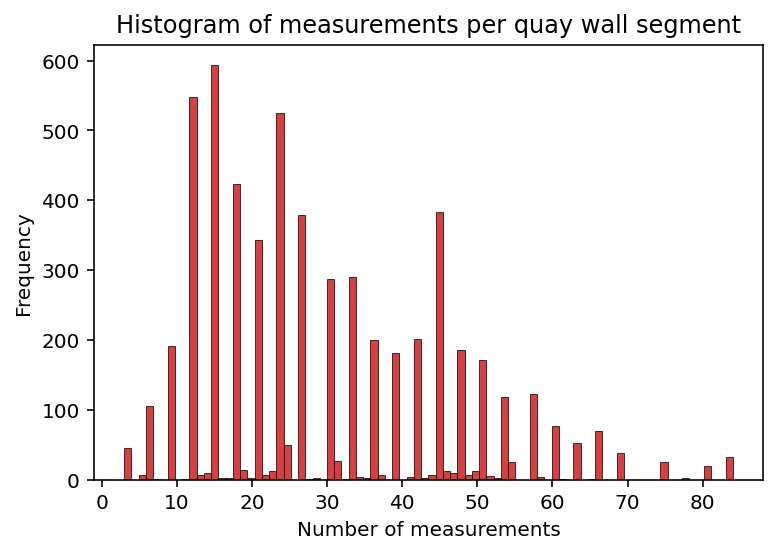

In [11]:
%config InlineBackend.figure_format='retina'

# count non-NaN per column and make histogram
sns.histplot(df_tcmt.count(axis=1), bins=84, color=(0.8,0,0))
plt.title('Histogram of measurements per quay wall segment')
plt.xlabel('Number of measurements')
plt.ylabel('Frequency')
plt.show()

The following figures show that the distribution of measurements for the X- and Y-direction are similar. For the Z-direction, lower numbers of measurement are more frequent than for the X- and Y-direction, and higher numbers of measurement are less frequent. This means the measurement in Z-direction is more frequently missing.

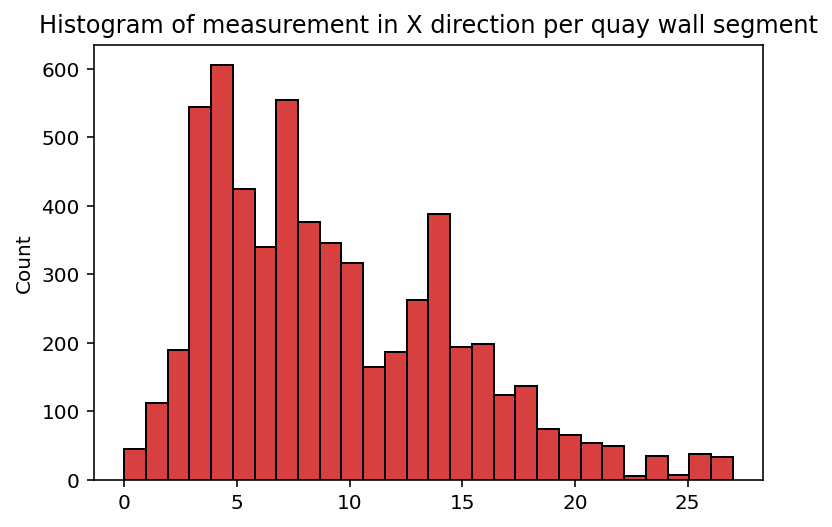

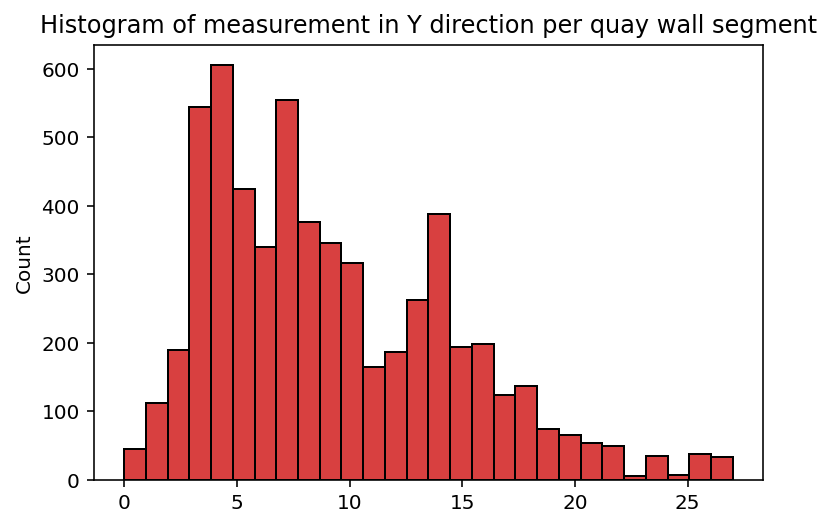

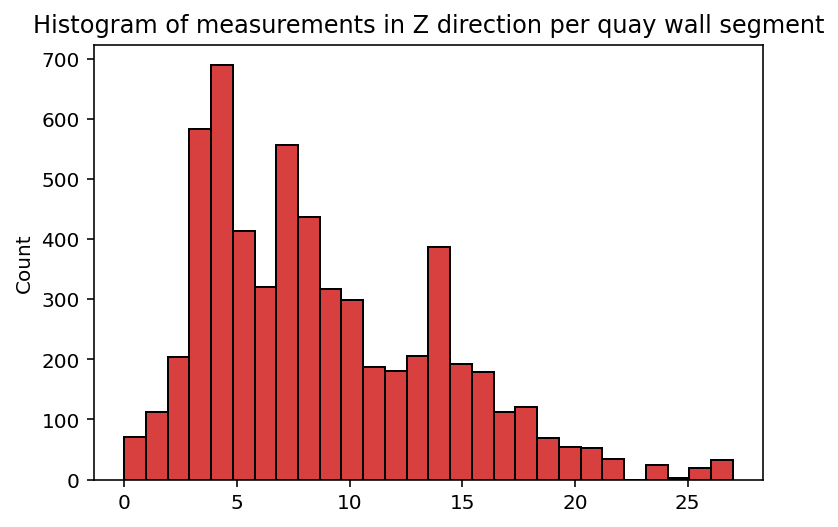

In [12]:
# Take every dX column, count non-NaN values, and make histogram
sns.histplot(df_tcmt[[col for i, col in enumerate(df_tcmt.columns[3:]) \
                      if i%3 == 0]].count(axis=1), color=(0.8,0,0))
plt.title('Histogram of measurement in X direction per quay wall segment')
plt.show()

# Take every dY column, count non-NaN values, and make histogram
sns.histplot(df_tcmt[[col for i, col in enumerate(df_tcmt.columns[3:]) \
                      if i%3 == 1]].count(axis=1), color=(0.8,0,0))
plt.title('Histogram of measurement in Y direction per quay wall segment')
plt.show()

# Take every dZ column, count non-NaN values, and make histogram
sns.histplot(df_tcmt[[col for i, col in enumerate(df_tcmt.columns[3:]) \
                      if i%3 == 2]].count(axis=1), color=(0.8,0,0))
plt.title('Histogram of measurements in Z direction per quay wall segment')
plt.show()

In [13]:
# get all dX in one column
Xes = df_tcmt[[col for i, col in enumerate(df_tcmt.columns[3:]) \
               if i%3 == 0]].stack().reset_index()

# get all dY in one column
Ys = df_tcmt[[col for i, col in enumerate(df_tcmt.columns[3:]) \
              if i%3 == 1]].stack().reset_index() 

# get all dZ in one column
Zs = df_tcmt[[col for i, col in enumerate(df_tcmt.columns[3:]) \
              if i%3 == 2]].stack().reset_index() 

# combine into one dataframe
Xes[1] = Ys[0]
Xes[2] = Zs[0]
Xes = Xes.rename(columns={0:'dX', 1:'dY', 2:'dZ'})

Xes.min(), Xes.max()

(level_0            0
 level_1           X0
 dX        -2115280.4
 dY        -4999433.1
 dZ            -722.7
 dtype: object,
 level_0      6672
 level_1       X99
 dX         6146.3
 dY          587.7
 dZ           96.3
 dtype: object)

The minimum values for dX and dY are not realistic. In most cases, a quay wall is about one meter high. Remember that these measurements are in mm. So any absolute value beyond 1000 is unrealistic. Therefore, these are filtered.

C:\Users\julia\anaconda3\lib\site-packages\seaborn\categorical.py:82: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


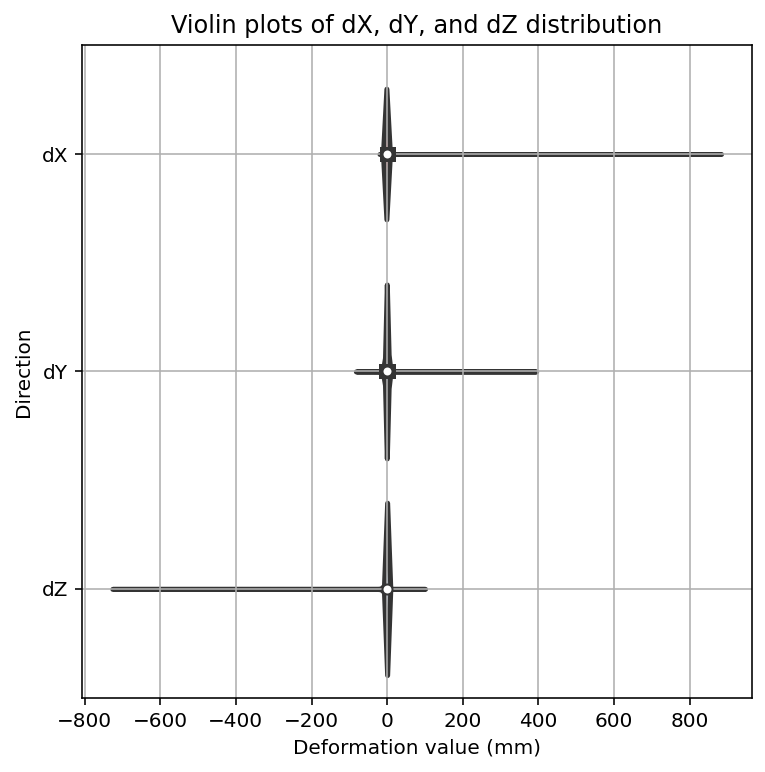

In [14]:
# remove all absolute values exceeding 1000
Xes_filtered = Xes[abs(Xes['dX']) < 1000]
Xes_filtered2 = Xes_filtered[abs(Xes_filtered['dY']) < 1000]
Xes_filtered3 = Xes_filtered2[abs(Xes_filtered2['dZ']) < 1000]


fig, ax = plt.subplots(figsize=(6,6))

# draw violin plot
sns.violinplot(data=Xes_filtered3[['dX', 'dY', 'dZ']], ax=ax, orient='h', \
               linewidth=2.5, palette=sns.color_palette([(0.8,0,0), '#1b4594', '#a2cffe']))
plt.grid()
plt.title('Violin plots of dX, dY, and dZ distribution')
plt.ylabel('Direction')
plt.xlabel('Deformation value (mm)')
plt.show()

For visualisation purposes the violin plot is also drawn with an interval of (-20, 20) for the deformation value. The figure shows a nearly perfect normal distribution with median equalling zero for dX, and negatively skewed distributions with negative medians for dY and dZ.

C:\Users\julia\anaconda3\lib\site-packages\seaborn\categorical.py:82: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


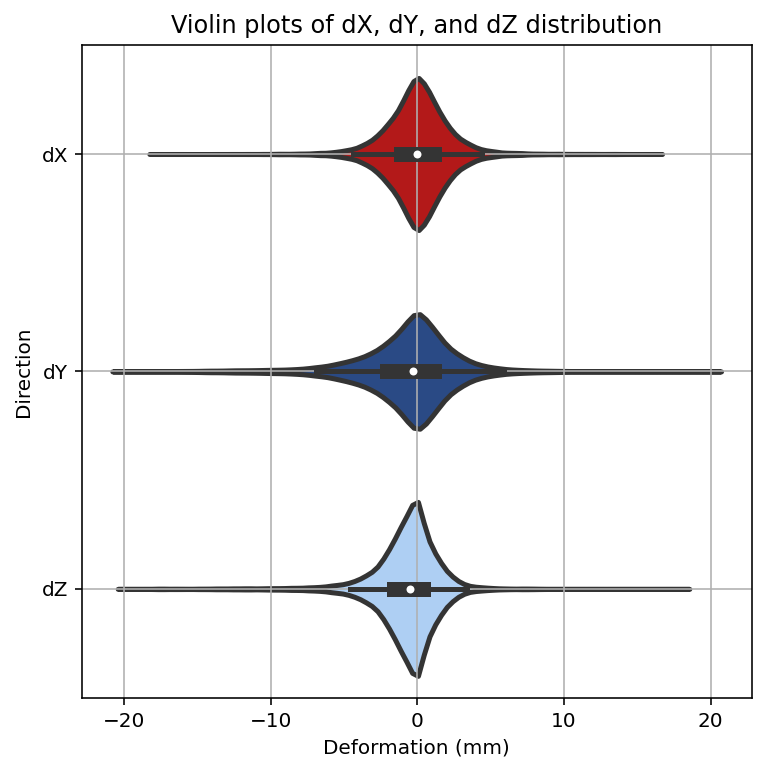

In [15]:
# remove all absolute values exceeding 20
Xes_filtered = Xes[abs(Xes['dX']) < 20]
Xes_filtered2 = Xes_filtered[abs(Xes_filtered['dY']) < 20]
Xes_filtered3 = Xes_filtered2[abs(Xes_filtered2['dZ']) < 20]

fig, ax = plt.subplots(figsize=(6,6))

# draw violin plot
sns.violinplot(data=Xes_filtered3[['dX', 'dY', 'dZ']], ax=ax, orient='h', \
               linewidth=2.5, palette=sns.color_palette([(0.8,0,0), '#1b4594', '#a2cffe']))
plt.grid()
plt.title('Violin plots of dX, dY, and dZ distribution')
plt.ylabel('Direction')
plt.xlabel('Deformation (mm)')
plt.show()

The following figure shows the map of monitored quay walls

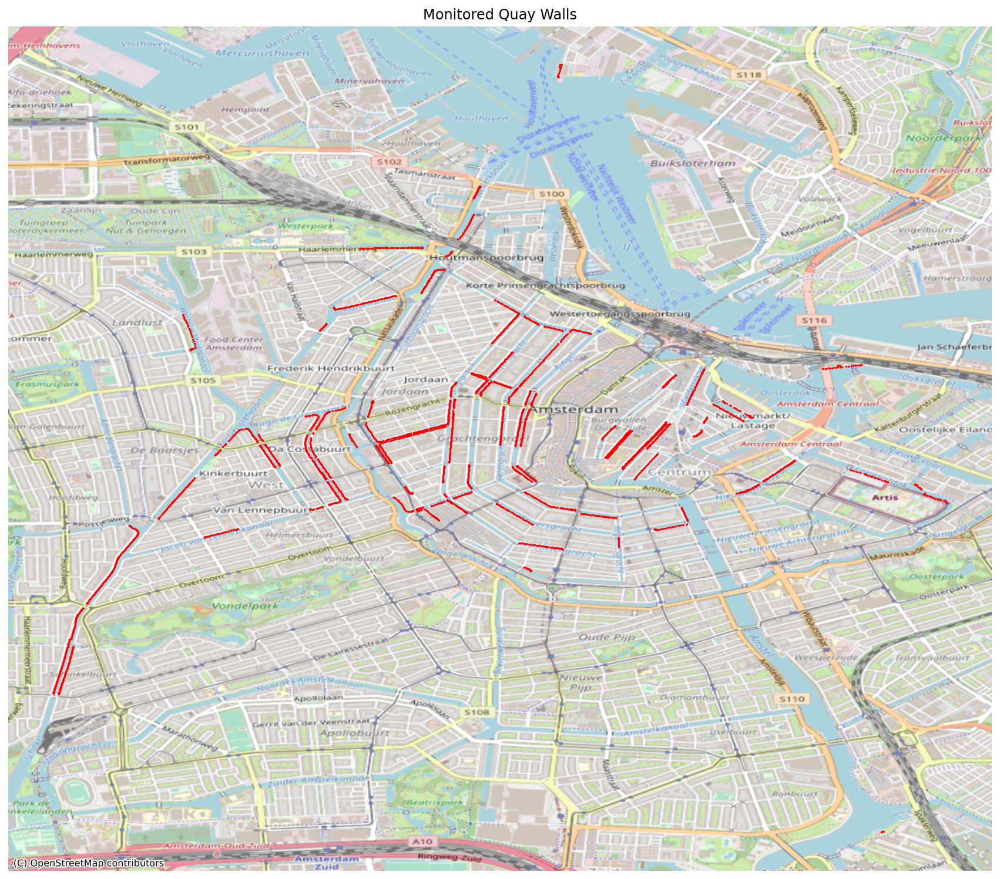

In [16]:
# create geo dataframe based on X and Y coordinates
gdf_tcmt = gpd.GeoDataFrame(df_tcmt, geometry=gpd.points_from_xy(df_tcmt['X_coordinate'], \
                                                                 df_tcmt['Y_coordinate']))

# add the correct coordinate system (Dutch RD)
gdf_tcmt.crs = "EPSG:28992"

# project onto gps coordinate system for visualisation purposes
gdf_tcmt = gdf_tcmt.to_crs("EPSG: 4326")

fig, ax = plt.subplots(figsize=(15,15))

# plot datapoints
gdf_tcmt.plot(ax=ax, color='red', markersize=0.5)

# add background of city of Amsterdam
cx.add_basemap(ax=ax, source=cx.providers.OpenStreetMap.Mapnik, crs=gdf_tcmt.crs)

ax.axis('off')
plt.title('Monitored Quay Walls')
plt.show()

### CPT Analysis

In [17]:
df_cpt.shape

(14105540, 12)

In [18]:
df_cpt.isna().any()

penetrationLength       False
coneResistance           True
localFriction            True
frictionRatio            True
easting                 False
northing                False
groundlevel             False
depth                    True
elapsedTime              True
inclinationResultant     True
inclinationEW            True
inclinationNS            True
dtype: bool

In [19]:
df_cpt.dtypes

penetrationLength       float64
coneResistance          float64
localFriction           float64
frictionRatio           float64
easting                 float64
northing                float64
groundlevel             float64
depth                   float64
elapsedTime             float64
inclinationResultant    float64
inclinationEW           float64
inclinationNS           float64
dtype: object

In [20]:
df_cpt.describe()

,penetrationLength,coneResistance,localFriction,frictionRatio,easting,northing,groundlevel,depth,elapsedTime,inclinationResultant,inclinationEW,inclinationNS
count,1.410554e+07,1.404478e+07,1.269169e+07,5.165710e+06,1.410554e+07,1.410554e+07,1.410554e+07,4.239395e+06,3.877769e+06,5.552827e+06,1.501722e+06,1.504735e+06
mean,1.498089e+01,8.623406e+00,8.463000e-02,1.908395e+00,1.209733e+05,4.867998e+05,4.999629e-01,1.589187e+01,1.493349e+03,2.030933e+00,4.898237e-01,4.082991e-01
std,9.507182e+00,1.057361e+01,9.266195e-02,2.195245e+00,1.164839e+03,1.570480e+03,1.457339e+00,9.679303e+00,1.632007e+03,2.606649e+00,2.787496e+00,2.686690e+00
min,0.000000e+00,-9.460000e-01,-1.000000e-01,0.000000e+00,1.183444e+05,4.831213e+05,-1.003000e+01,0.000000e+00,0.000000e+00,0.000000e+00,-2.000000e+01,-1.600000e+01
25%,7.550000e+00,7.300000e-01,1.600000e-02,8.000000e-01,1.201800e+05,4.856830e+05,3.800000e-01,8.103000e+00,5.860000e+02,0.000000e+00,0.000000e+00,0.000000e+00
50%,1.418500e+01,3.020000e+00,5.000000e-02,1.200000e+00,1.209710e+05,4.868512e+05,5.960000e-01,1.519300e+01,1.089000e+03,1.000000e+00,0.000000e+00,0.000000e+00
75%,2.096500e+01,1.479000e+01,1.260000e-01,2.200000e+00,1.217542e+05,4.879005e+05,1.100000e+00,2.262700e+01,1.835300e+03,3.000000e+00,2.000000e+00,1.000000e+00
max,8.032300e+01,1.561600e+02,1.938000e+00,1.000000e+02,1.241480e+05,4.908517e+05,5.793000e+00,7.425000e+01,2.970920e+04,2.000000e+01,1.900000e+01,1.900000e+01


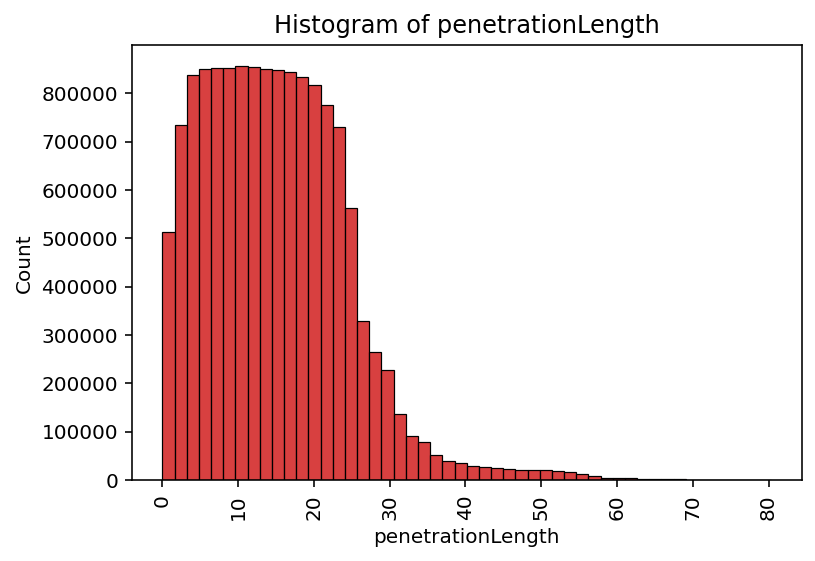

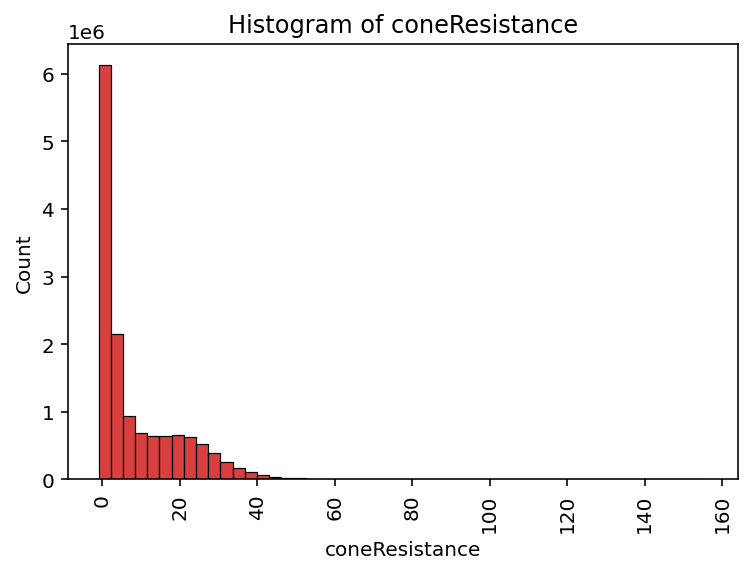

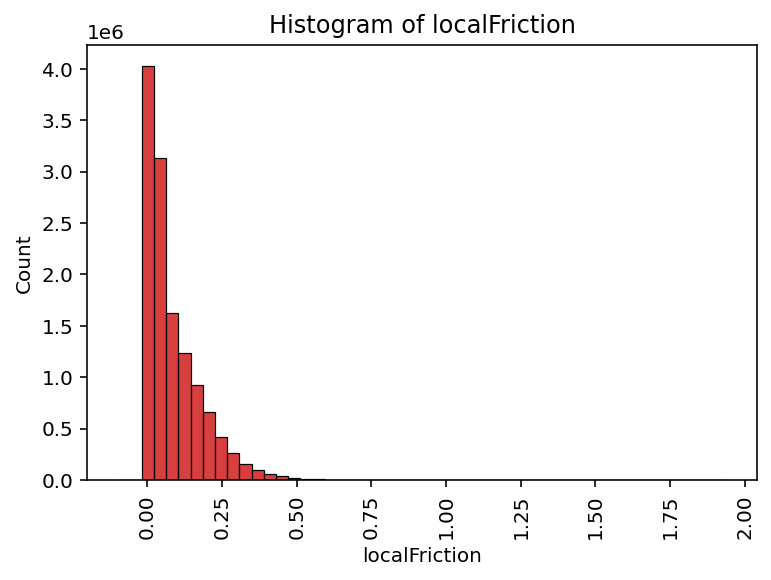

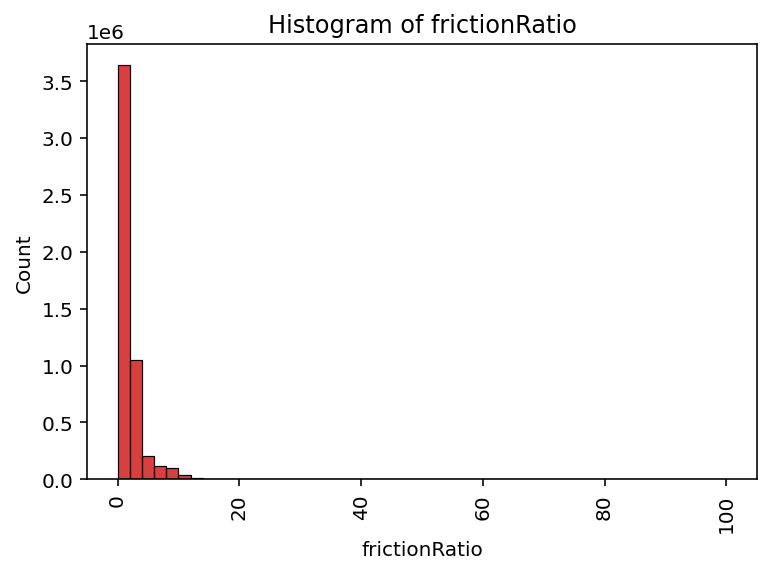

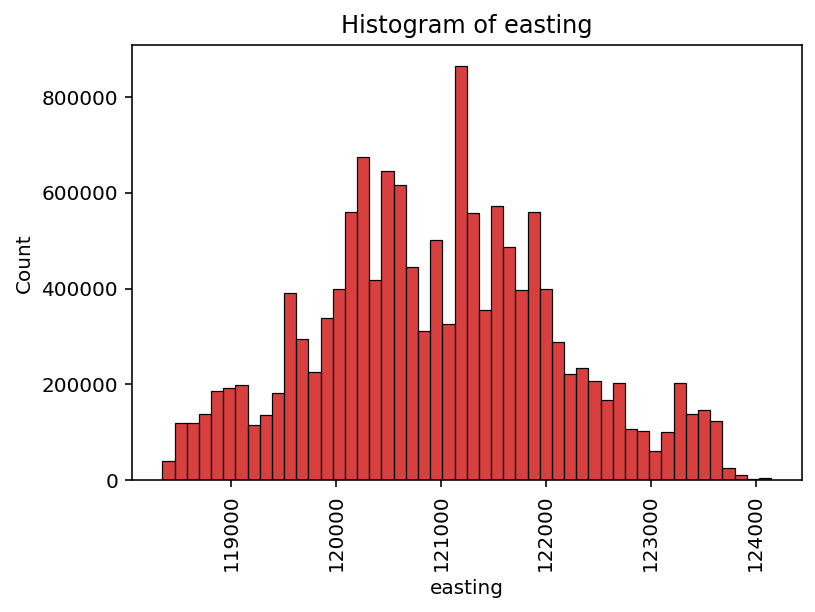

...

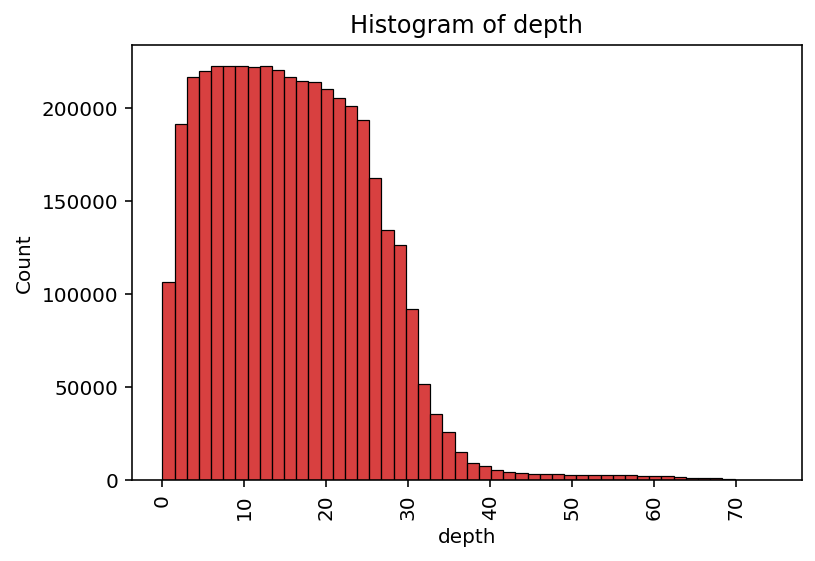

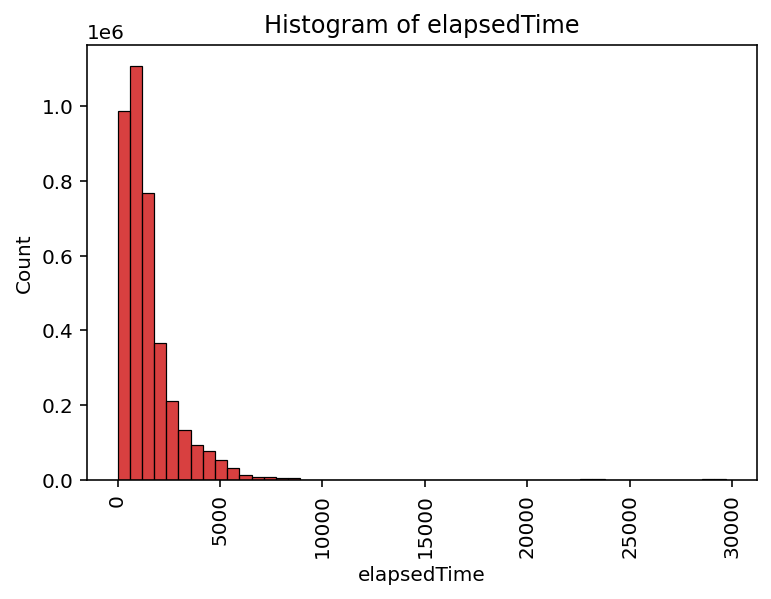

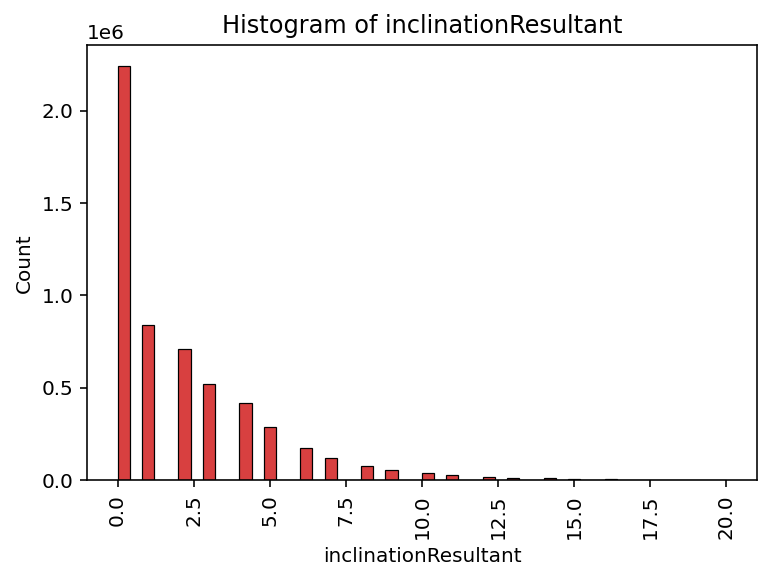

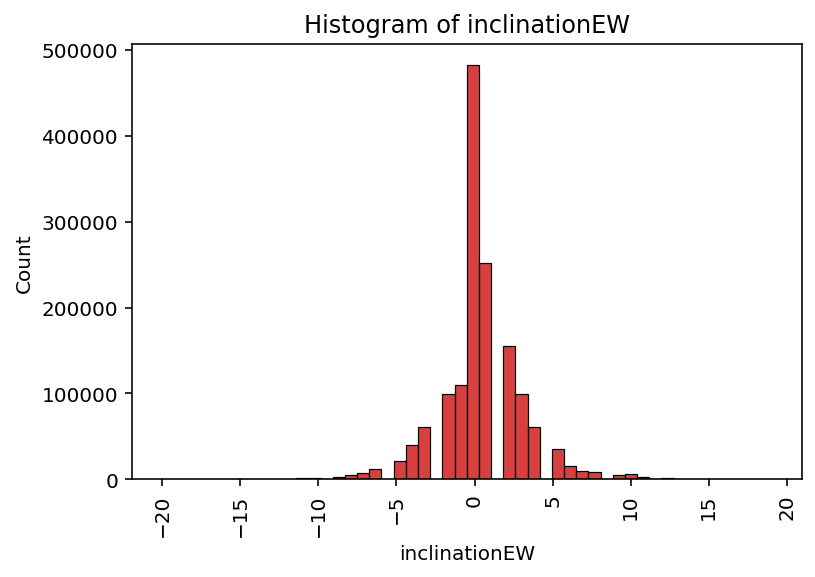

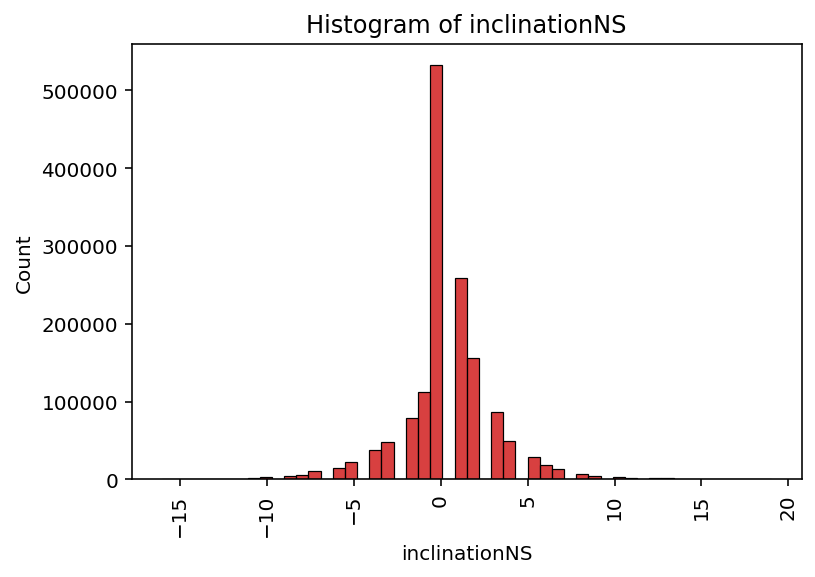

In [21]:
# iterate over columns
for col in df_cpt:
    
    # create histogram for column
    sns.histplot(df_cpt[col], bins=50, color=(0.8, 0, 0))
    plt.xticks(rotation=90)
    plt.title(f"Histogram of {col}")
    plt.show()

The histogram of penetrationLength shows that most values for this variable are between 0 and 30.
The histogram of coneResistance shows that most values for this variable are between 0 and 5.
The histogram of localFriction seems to follow a logarithmic decrease in frequency from zero to 2.
The histogram of frictionRatio shows an even faster decrease.
The histograms of easting and northing look somewhat normally distributed. This means there are more datapoint near the center of the city and less at the sides.
The histogram of groundlevel peaks at 0.5, and the majority of the values are between zero and 2.
The histogram of depth looks very similar to that of penetrationLength.
The histogram of elapsedTime indicates that values over 5000 are very uncommon. The unit of this variable is not clear.
The histogram of inclinationResultant indicates that the variable is not continuous. 
The histograms of inclinationEW and inclinationNS show a near normal distribution.


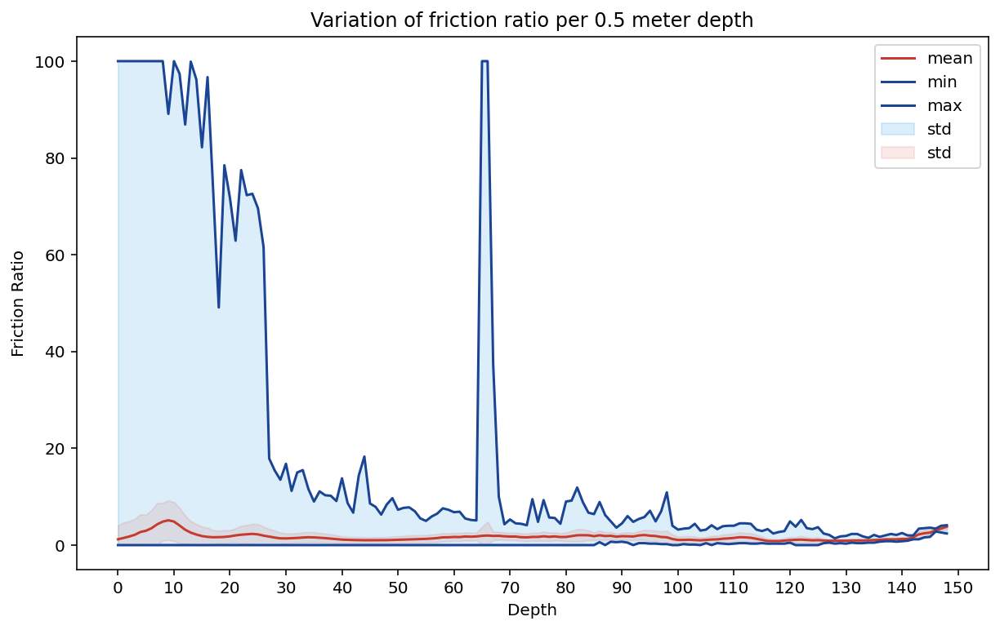

In [22]:
fig, ax = plt.subplots(figsize =(10,6))

# create depth intervals of 0.5 meter
cut = pd.cut(df_cpt['depth'], bins=[i*0.5 for i in range(0, 150)])

# calculate mean/min/max/std values of friction ratio per depth interval
mean = pd.Series(df_cpt.groupby(cut)['frictionRatio'].mean().values)
minimum = pd.Series(df_cpt.groupby(cut)['frictionRatio'].min().values)
maximum = pd.Series(df_cpt.groupby(cut)['frictionRatio'].max().values)
std = pd.Series(df_cpt.groupby(cut)['frictionRatio'].std().values)
lower = mean - std
upper = mean + std

# plotting
mean.plot(color='#c73a2d', label='mean')
minimum.plot(color='#1b4594', label='min')
maximum.plot(color='#1b4594', label='max')
ax.fill_between(mean.index, minimum, maximum, \
                alpha=0.2, color='#4daae8', label='std')
ax.fill_between(mean.index, np.maximum(lower, minimum), upper, \
                alpha=0.1, color='#d82f20', label='std')

plt.xticks([i*10 for i in range(0, 16)])
plt.title('Variation of friction ratio per 0.5 meter depth')
plt.xlabel('Depth')
plt.ylabel('Friction Ratio')
plt.legend()
plt.show()

The plot above shows that there is a big variation at the first 30 meters of depth for the friction ratio. The same goes for between 60 and 70 meters. Given the mean value and the standard deviation being relatively small, this could indicate outliers. 

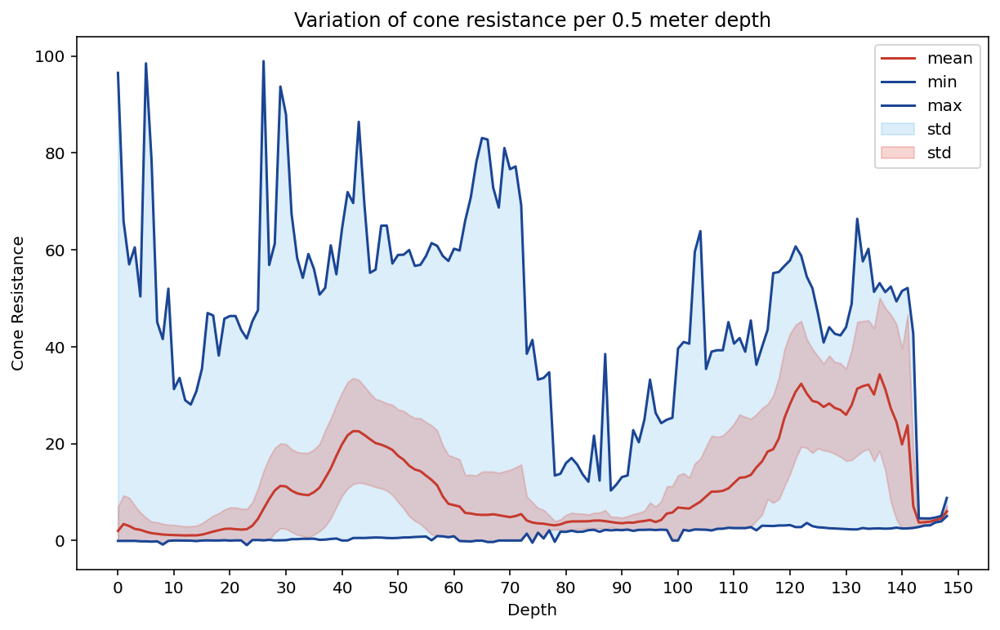

In [23]:
fig, ax = plt.subplots(figsize =(10,6))

# calculate mean/min/max/std of cone resistance per depth interval
mean = pd.Series(df_cpt.groupby(cut)['coneResistance'].mean().values)
minimum = pd.Series(df_cpt.groupby(cut)['coneResistance'].min().values)
maximum = pd.Series(df_cpt.groupby(cut)['coneResistance'].max().values)
std = pd.Series(df_cpt.groupby(cut)['coneResistance'].std().values)
lower = mean - std
upper = mean + std

# plotting
mean.plot(color='#c73a2d', label='mean')
minimum.plot(color='#1b4594', label='min')
maximum.plot(color='#1b4594', label='max')
ax.fill_between(mean.index, minimum, maximum, alpha=0.2, color='#4daae8', label='std')
ax.fill_between(mean.index, np.maximum(lower, minimum), upper, \
                alpha=0.2, color='#d82f20', label='std')

plt.xticks([i*10 for i in range(0, 16)])
plt.title('Variation of cone resistance per 0.5 meter depth')
plt.xlabel('Depth')
plt.ylabel('Cone Resistance')
plt.legend()
plt.show()

The above plot idicates much variation in the variable of cone resistance. This indicates the soil setting to vary widely throughout the city.

In [24]:
# create geo dataframe based on X and Y coordinates
gdf_cpt = gpd.GeoDataFrame(df_cpt, geometry=gpd.points_from_xy(df_cpt['easting'], \
                                                               df_cpt['northing']))

# add the correct coordinate system (Dutch RD)
gdf_cpt.crs = "EPSG:28992"

# project onto gps coordinate system for visualisation purposes
gdf_cpt = gdf_cpt.to_crs("EPSG: 4326")
gdf_cpt

# take only rows with maximum value of groundlevel per location, to get only one row per location
gdf_cpt_vis = gdf_cpt.groupby(gdf_cpt['geometry'].to_wkt())['groundlevel'].max().reset_index()
gdf_cpt_vis.columns = ['geometry', 'groundlevel']

# turn geometry into geometry type again
gdf_cpt_vis['geometry'] = gpd.GeoSeries.from_wkt(gdf_cpt_vis['geometry'])
gdf_cpt_vis = gpd.GeoDataFrame(gdf_cpt_vis)
gdf_cpt_vis.crs = "EPSG:4326"
gdf_cpt_vis.shape

(5371, 2)

The following plot shows the spread of CPT datapoints across the city.

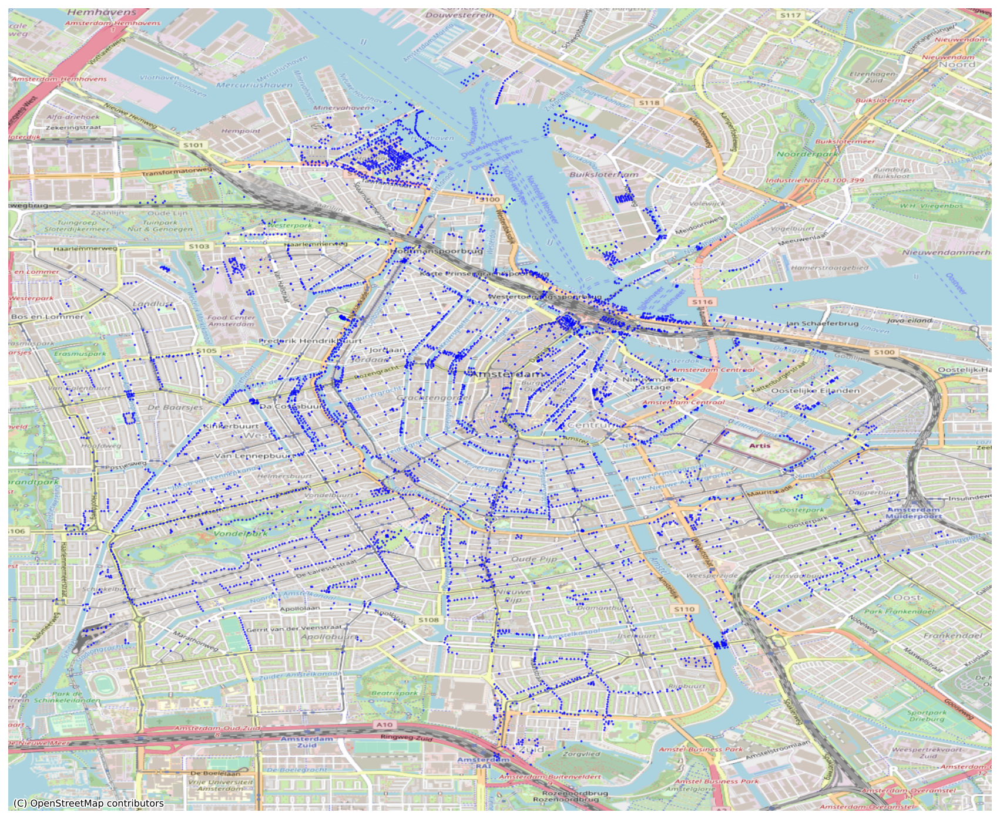

In [25]:
fig, ax = plt.subplots(figsize=(15,15))

# plot datapoints
gdf_cpt_vis.plot(ax=ax, color='blue', markersize=1, alpha=0.6)

# add background of city of Amsterdam
cx.add_basemap(ax=ax, source=cx.providers.OpenStreetMap.Mapnik, crs=gdf_cpt_vis.crs)

ax.axis('off')
plt.show()

The following plot shows the correlation matrix of the CPT data. Depth and penetrationLength have a Pearson's R of 1, and therefore seem to indicate the same thing. LocalFriction and ConeResistance are highly correlation with a Pearson's R of 0.9. This is interesting because together they indicate the type of soil at that depth.

C:\Users\julia\AppData\Local\Temp/ipykernel_11568/3749222793.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_cpt = df_cpt.corr().round(decimals=2)


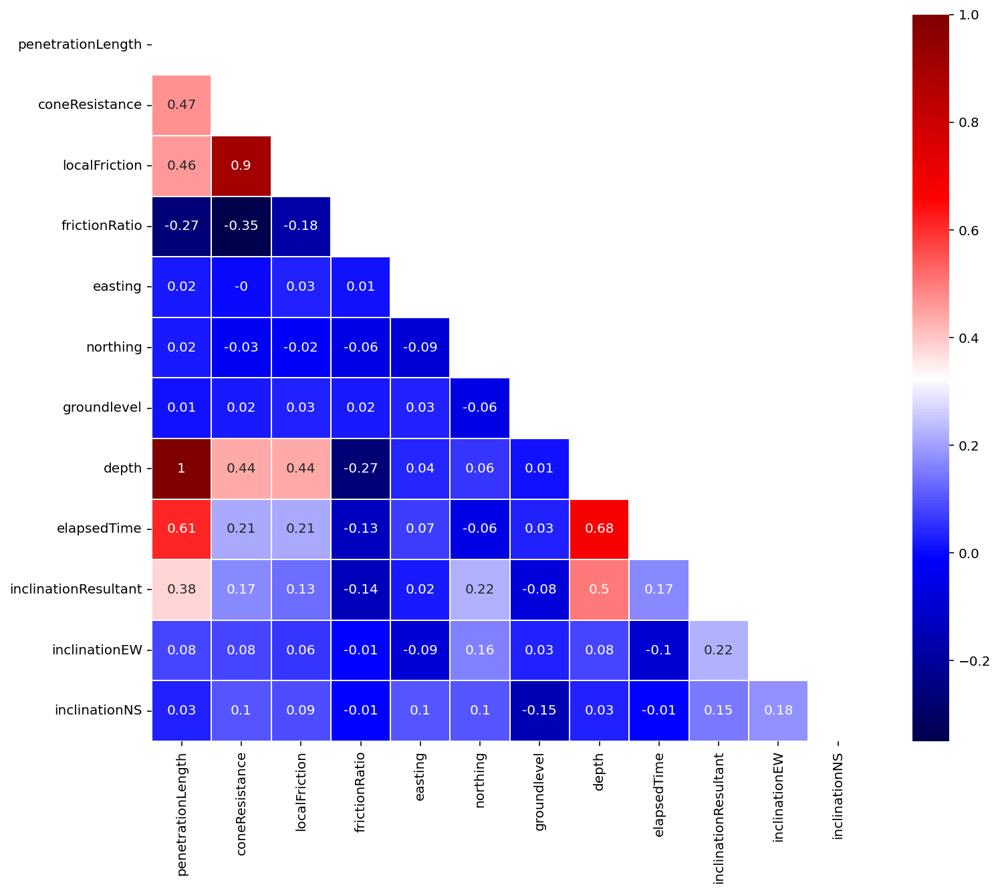

In [26]:
# Calculate Pearson's R for correlations between variables
corr_cpt = df_cpt.corr().round(decimals=2)

# mask to remove the top part of the correlation matrix
mask = np.triu(np.ones_like(corr_cpt, dtype=bool))

# plotting
plt.figure(figsize=(12, 10))
sns.heatmap(corr_cpt, linewidths=1, cmap="seismic", annot=True, mask=mask)
plt.show()

### Bore Analysis

In [27]:
df_bore.shape

(9395, 28)

In [28]:
df_bore.isna().any()

upperBoundary                False
lowerBoundary                False
anthropogenic                False
internalStructureIntact       True
geotechnicalSoilName          True
tertiaryConstituent           True
colour                        True
dispersedInhomogeneity        True
carbonateContentClass         True
organicMatterContentClass     True
sandMedianClass               True
sizeFraction                  True
angularity                    True
sphericity                    True
slant                         True
bedded                        True
fineSoilConsistency           True
compositeLayer                True
soilName                     False
upper_NAP                    False
lower_NAP                    False
environment                  False
easting                      False
northing                     False
groundlevel                  False
testid                       False
finaldepth                   False
date                         False
dtype: bool

In [29]:
df_bore.dtypes

upperBoundary                float64
lowerBoundary                float64
anthropogenic                 object
internalStructureIntact       object
geotechnicalSoilName          object
tertiaryConstituent           object
colour                        object
dispersedInhomogeneity        object
carbonateContentClass         object
organicMatterContentClass     object
sandMedianClass               object
sizeFraction                  object
angularity                    object
sphericity                    object
slant                         object
bedded                        object
fineSoilConsistency           object
compositeLayer                object
soilName                      object
upper_NAP                    float64
lower_NAP                    float64
environment                   object
easting                      float64
northing                     float64
groundlevel                  float64
testid                        object
finaldepth                   float64
d

In [30]:
df_bore.describe()

,upperBoundary,lowerBoundary,upper_NAP,lower_NAP,easting,northing,groundlevel,finaldepth
count,9395.000000,9395.000000,9395.000000,9395.000000,9395.000000,9395.000000,9395.000000,9395.000000
mean,9.200384,9.739155,-8.726595,-9.265366,121360.531209,487251.253672,0.473789,6.026573
std,6.081374,6.033863,6.268433,6.218810,785.535938,566.387433,1.696163,5.926991
min,0.000000,0.050000,-30.900000,-31.900000,120069.490000,486404.590000,-4.300000,0.300000
25%,3.600000,4.600000,-13.844000,-14.332500,120689.069000,486817.400000,0.514000,2.000000
50%,9.600000,10.000000,-9.293000,-9.900000,121141.400000,487140.770000,0.875000,2.000000
75%,14.000000,14.600000,-3.430500,-4.010500,121890.380000,487701.440000,1.254000,11.000000
max,29.100000,30.100000,6.570000,6.130000,124085.907000,488711.770000,6.630000,32.100000


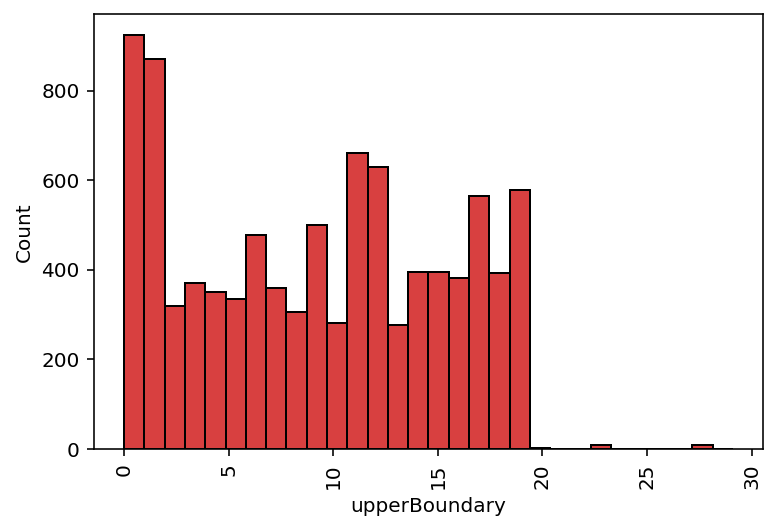

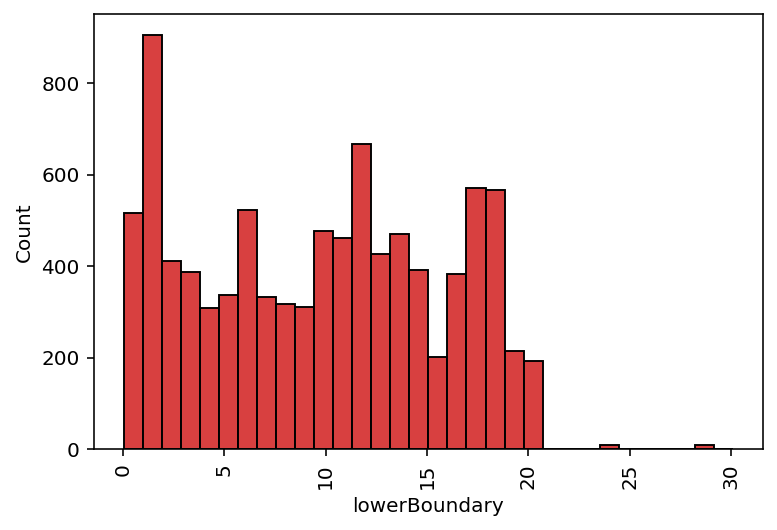

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


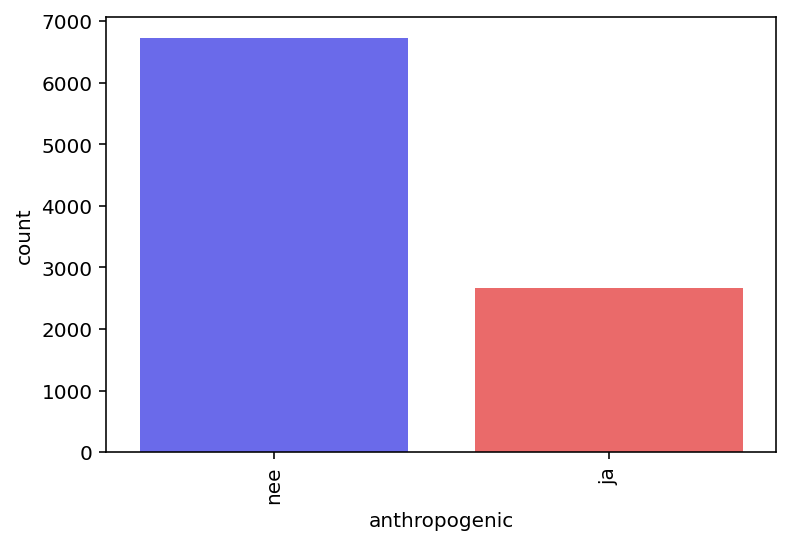

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


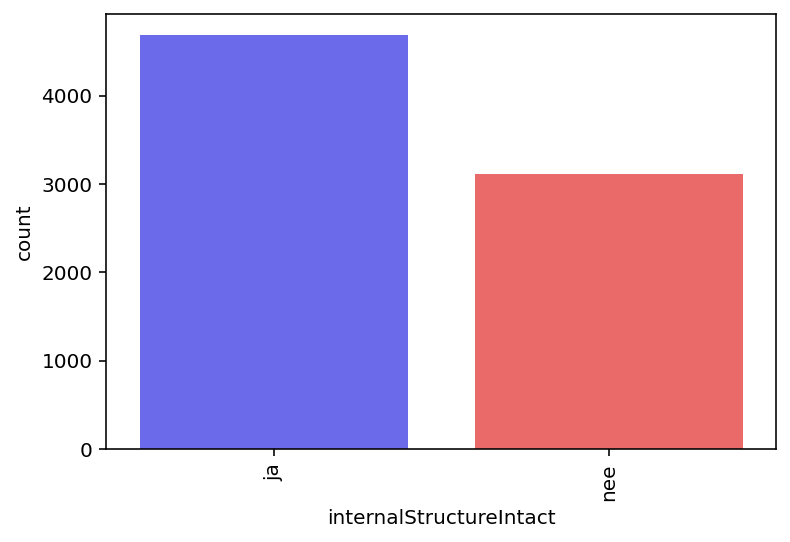

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


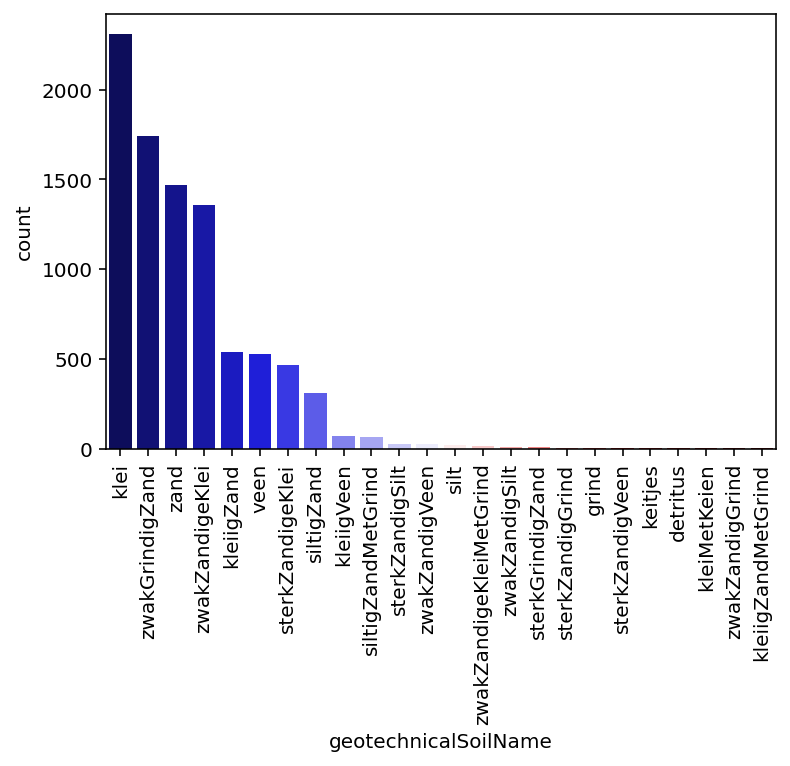

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


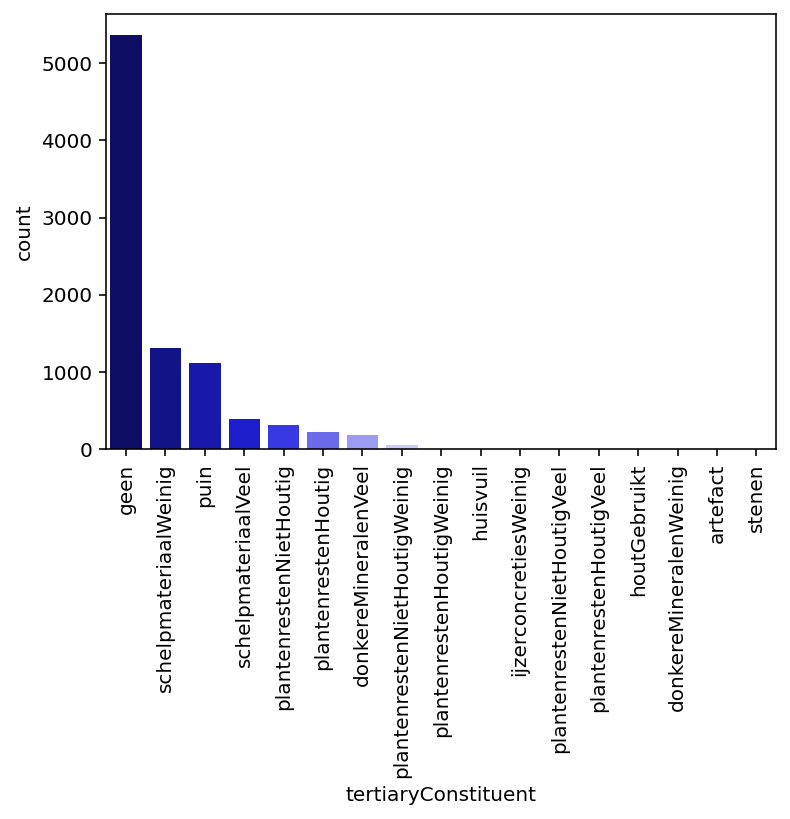

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


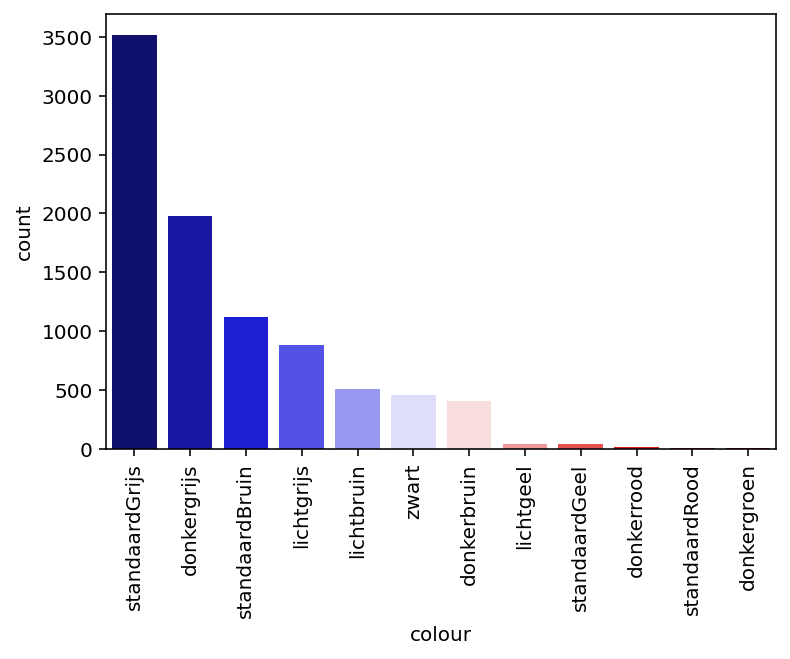

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


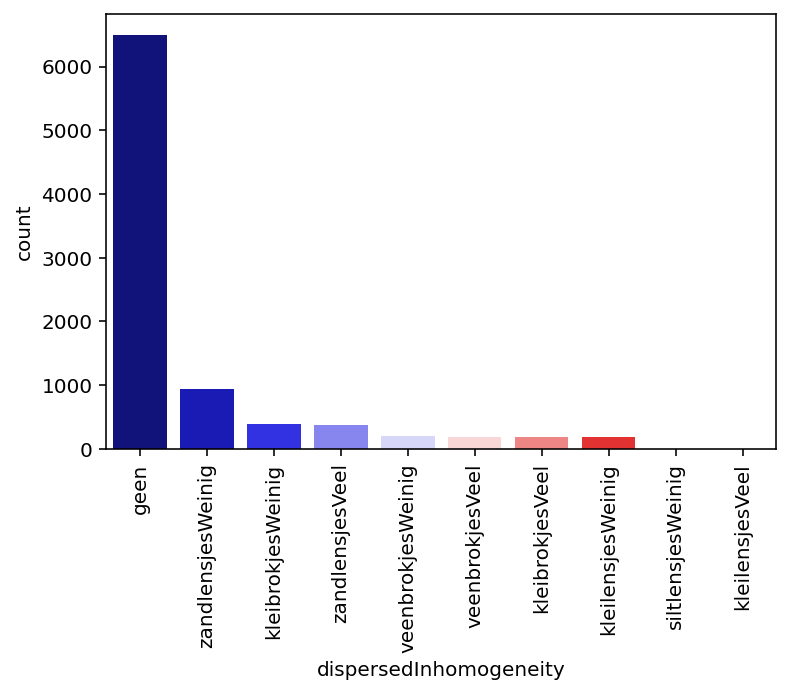

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


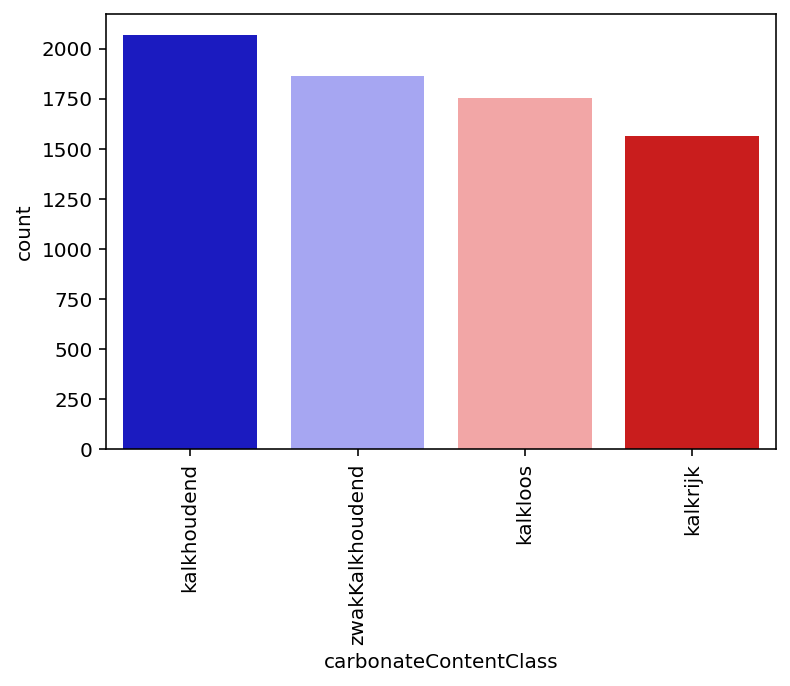

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


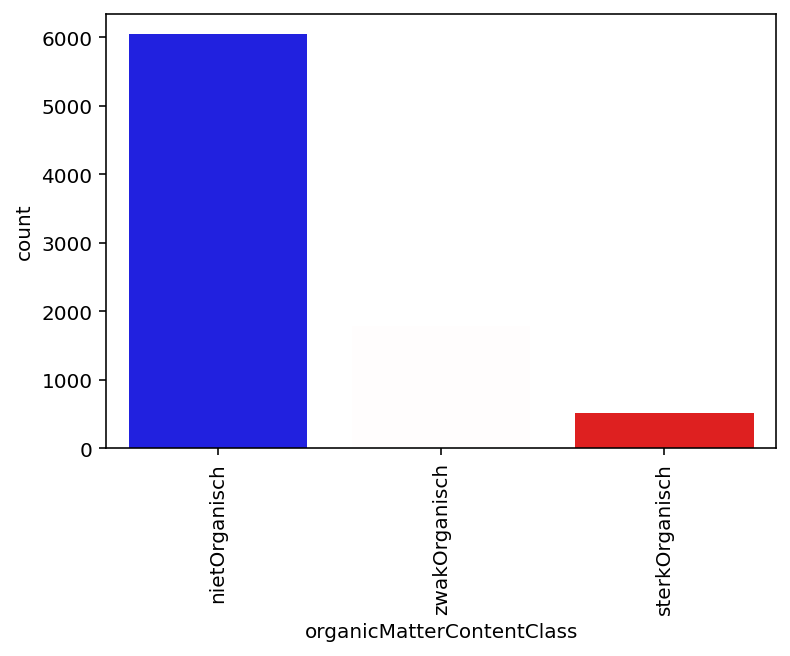

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


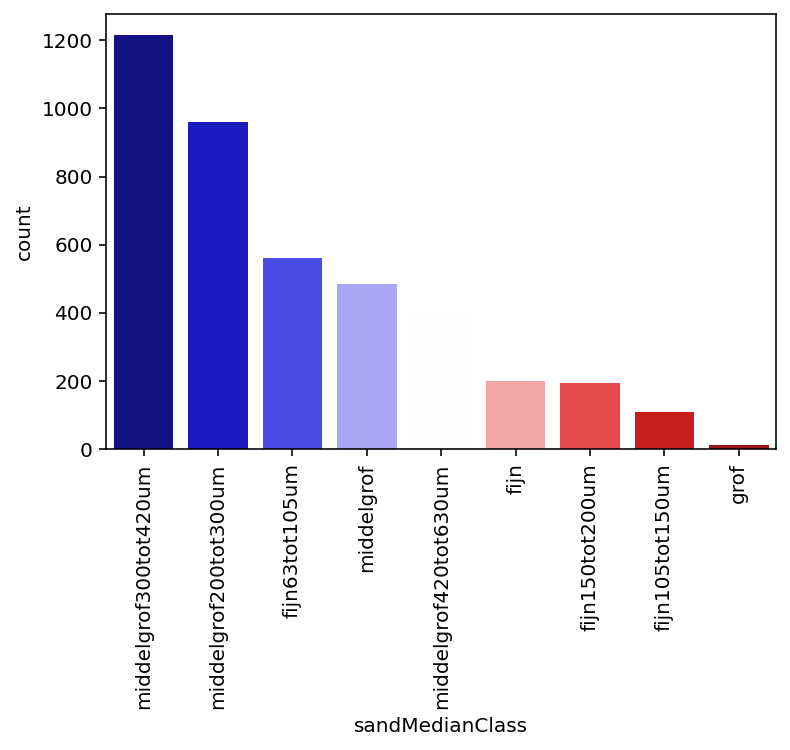

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


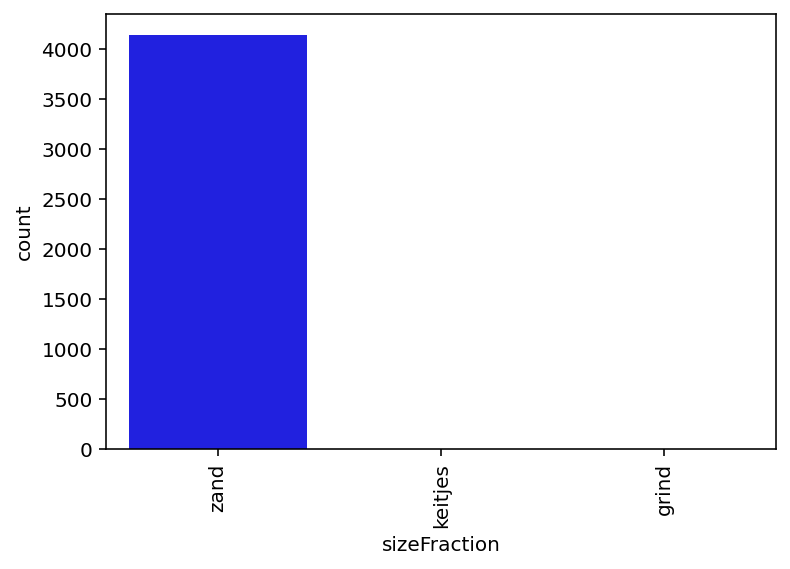

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


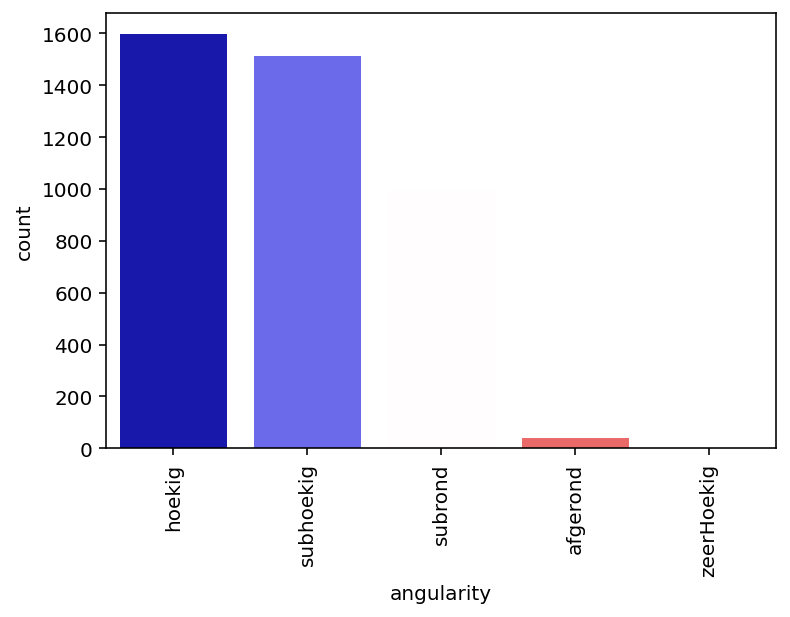

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


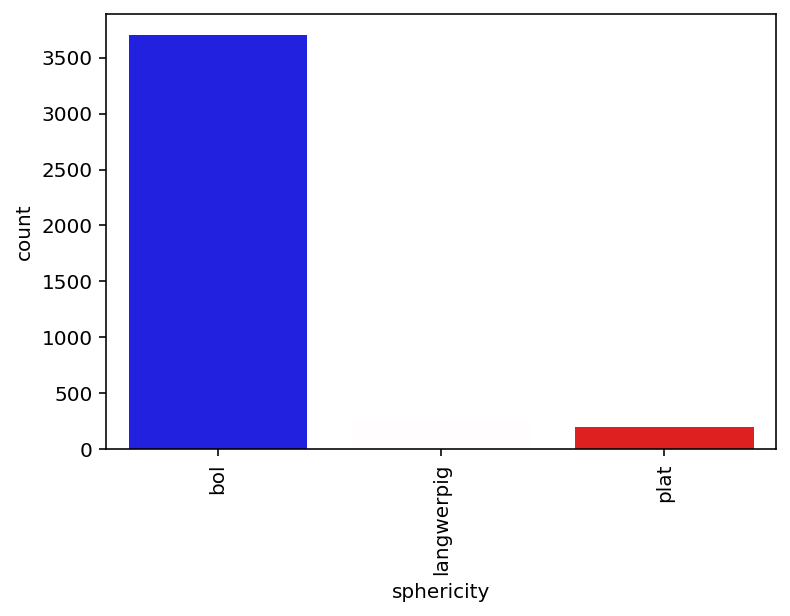

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


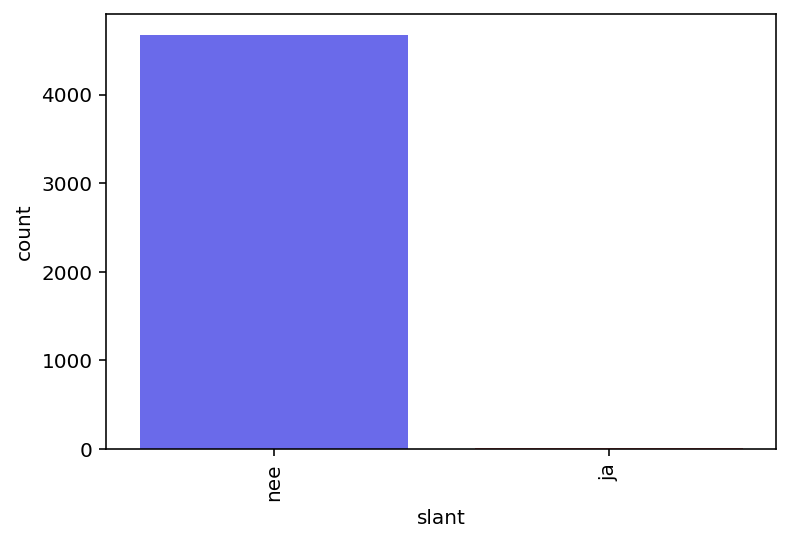

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


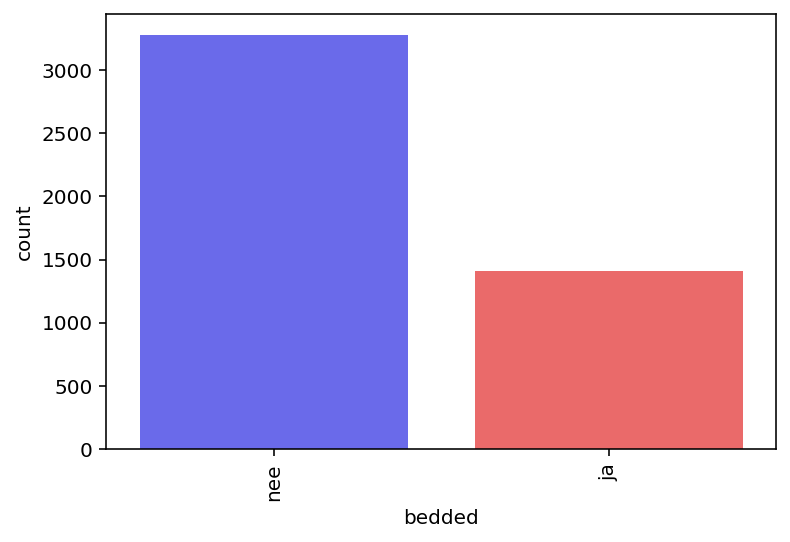

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


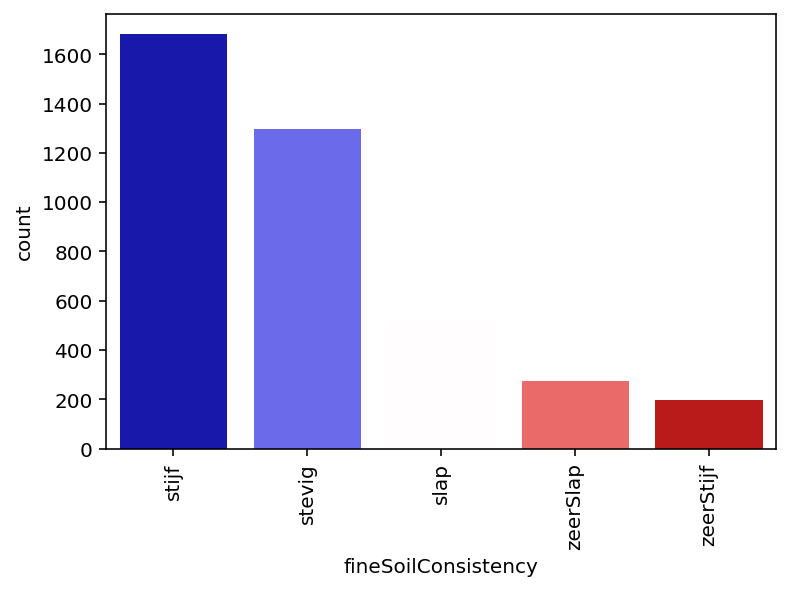

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


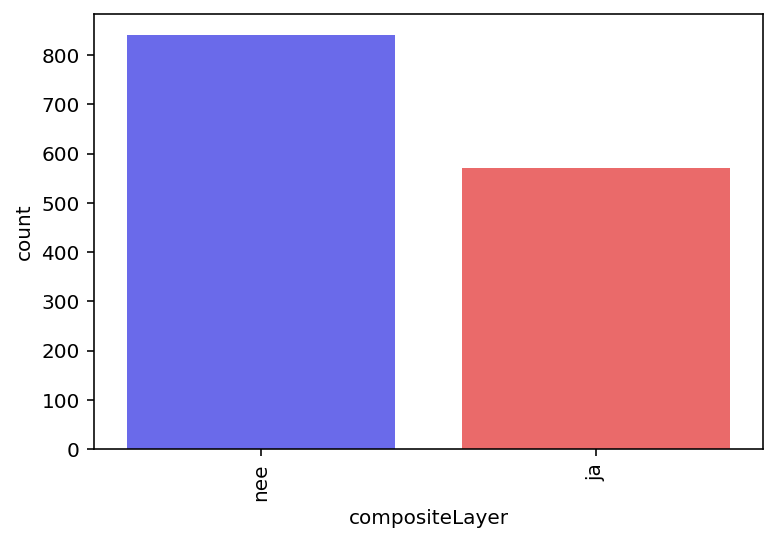

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


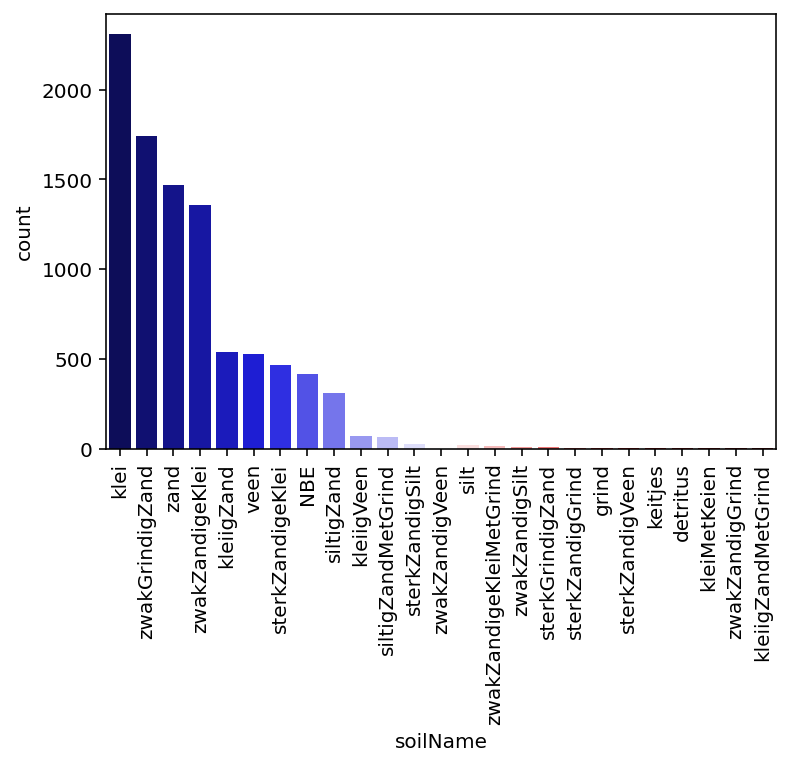

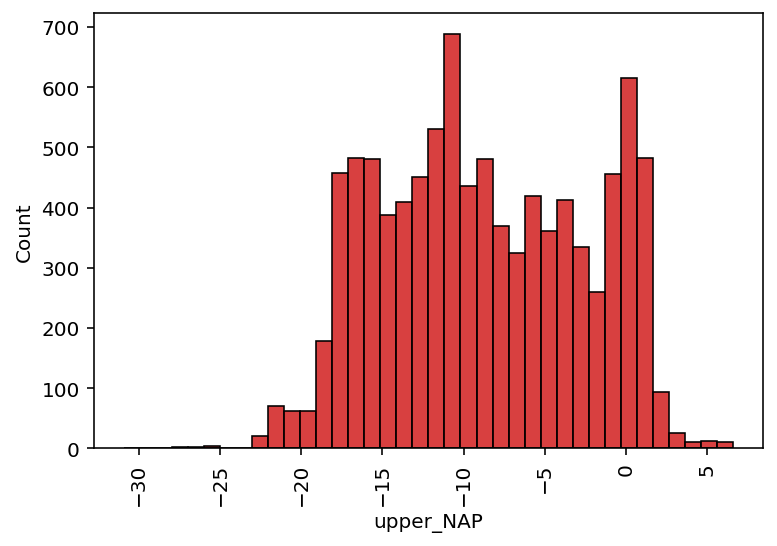

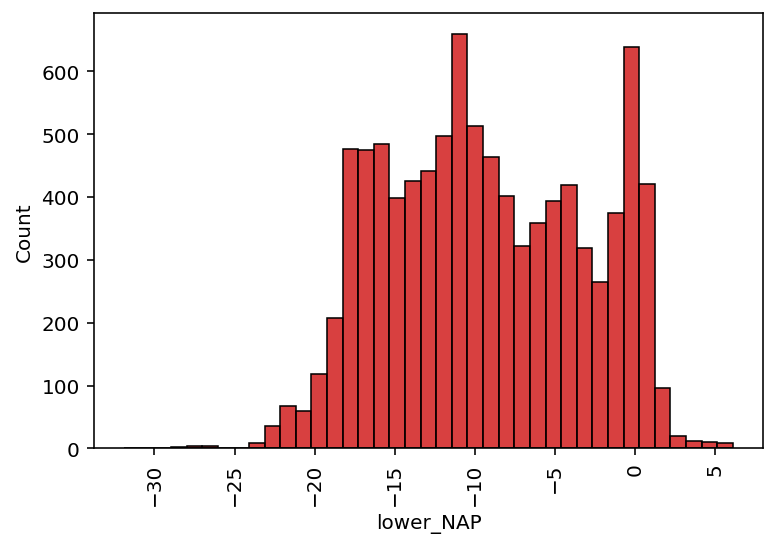

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


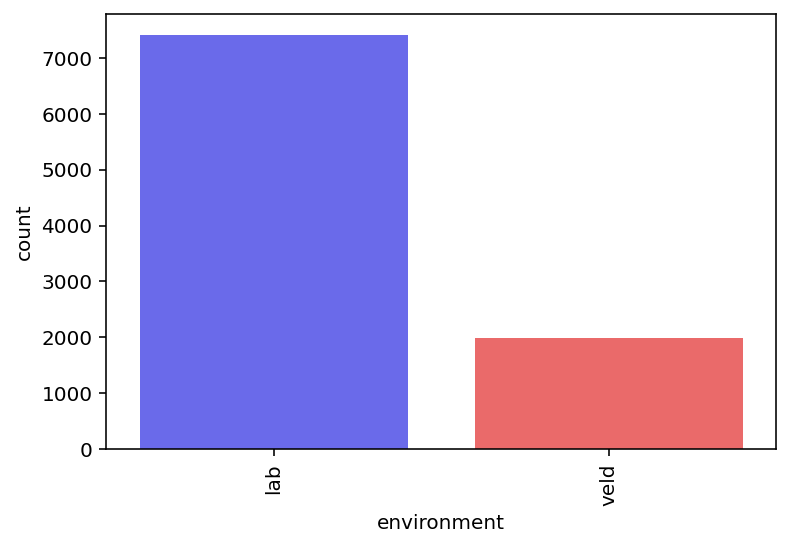

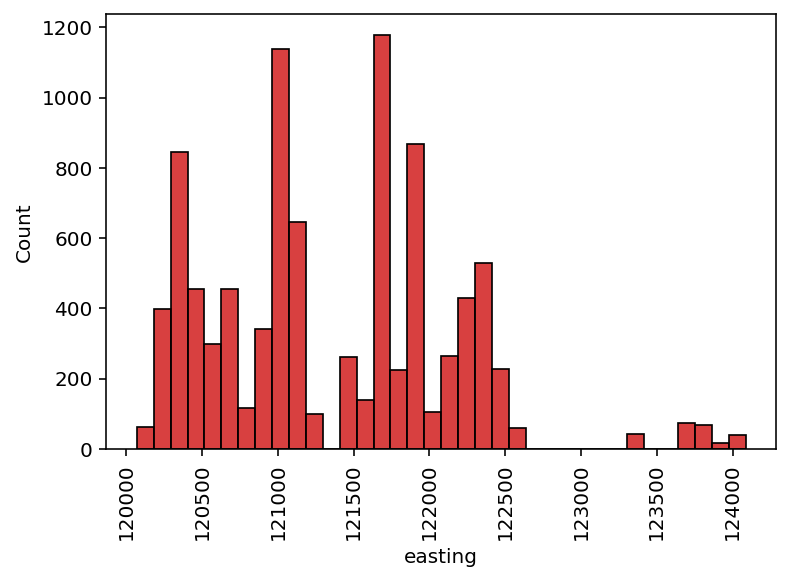

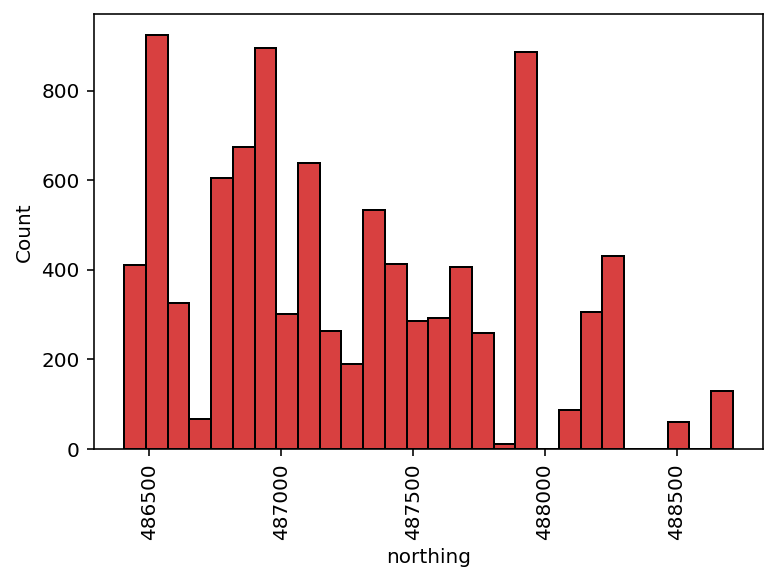

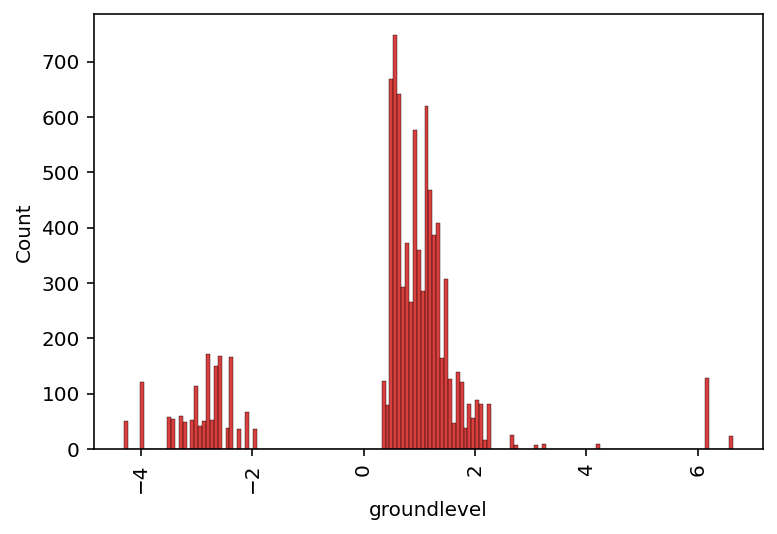

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


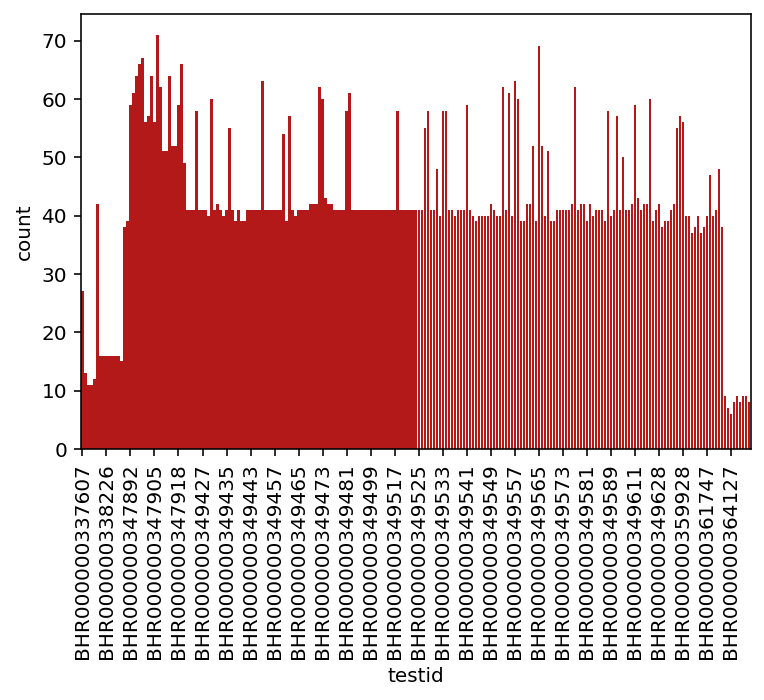

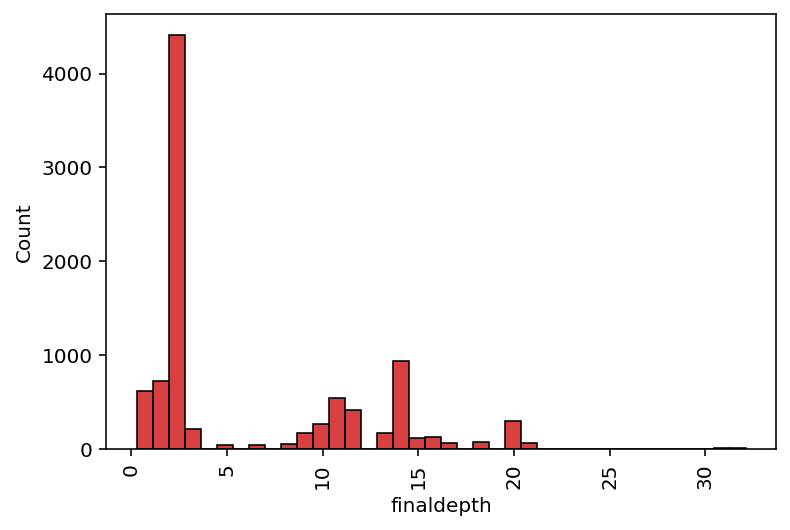

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


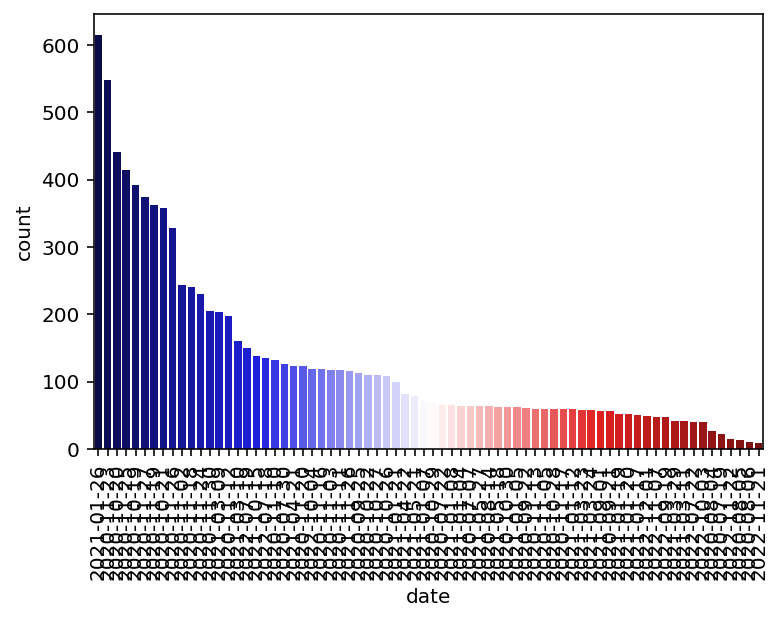

In [31]:
for col in df_bore:
    
    # show only every eighth id, in ascending order
    if col == 'testid':
        ids = sorted(df_bore[col].unique())
        x = [i for i in range(len(ids)) if i%8==0]
        sns.countplot(df_bore[col], order=ids, color=(0.8,0,0))
        plt.xticks(x, ids[::8])
        
    # if no numeric value, order on counts
    elif df_bore[col].dtype == 'object':
        sns.countplot(df_bore[col],
                     order=df_bore[col].value_counts().index, palette='seismic')
    
    # else plot histogram
    else:
        sns.histplot(df_bore[col], color=(0.8,0,0))
        
    plt.xticks(rotation=90)
    plt.show()


The histograms of upper and lower boundary show that most values are between 0 and 20. The histograms are very similar and could therefore indicate that usually a standard interval is used between the upper and lower boundary.
For most of the data, the soil is not anthropogenic.
For most of the data, the internal structure is intact.
Most of the soil is of type klei (clay). 
For most of the data there is no tertiary constituent.
Most of the soil is of colour Grey.
For most of the soil there is no dispersed inhomogeneity
Most of the soil is calcareous.
Most of the soil is not organic.


The following plot shows the spread of Bore datapoints across the city.

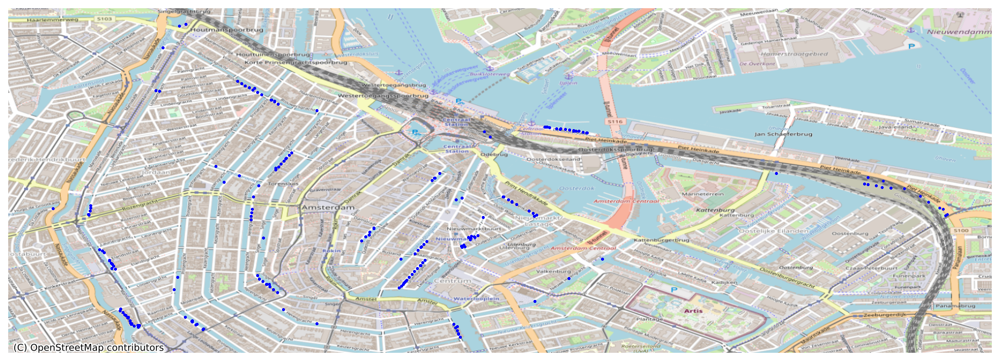

In [32]:
# create geo dataframe based on X and Y coordinates
gdf_bore = gpd.GeoDataFrame(df_bore, geometry=gpd.points_from_xy(df_bore['easting'], \
                                                                 df_bore['northing']))

# add the correct coordinate system (Dutch RD)
gdf_bore.crs = "EPSG:28992"

# project onto gps coordinate system for visualisation purposes
gdf_bore = gdf_bore.to_crs("EPSG:4326")

fig, ax = plt.subplots(figsize=(15,15))

# plot datapoints
gdf_bore.plot(ax=ax, color='blue', markersize=1, alpha=0.6)

# add background of city of Amsterdam
cx.add_basemap(ax=ax, source=cx.providers.OpenStreetMap.Mapnik, crs=gdf_bore.crs)

# don't show the axes
ax.axis('off')
plt.show()

The following figure shows the correlations between the numeric variables of the bore data. Not very interesting information there. Correlations for categorical variables would be more interesting, but given the sparsity of the datapoints across the city it is doubtful whether the data will be used anyway. This analysis is skipped for that reason.

C:\Users\julia\AppData\Local\Temp/ipykernel_11568/1281965701.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_bore = df_bore.corr().round(decimals=2)


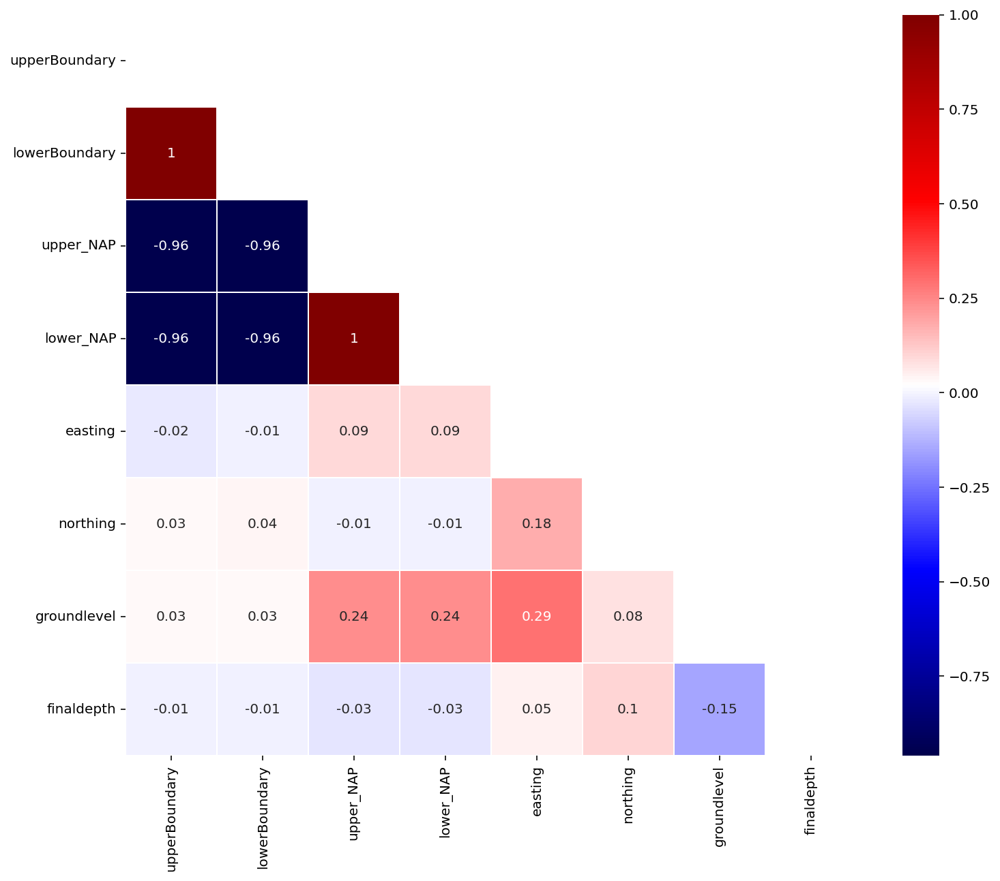

In [33]:
# Calculate Pearson's R for correlations between variables
corr_bore = df_bore.corr().round(decimals=2)

# mask to remove the top part of the correlation matrix
mask = np.triu(np.ones_like(corr_bore, dtype=bool))

# plotting
plt.figure(figsize=(12, 10))
sns.heatmap(corr_bore, linewidths=1, cmap="seismic", annot=True, mask=mask)
plt.show()

### Buildings Tacheometry Analysis

In [34]:
df_meetbouten.shape

(12937, 7)

In [35]:
df_meetbouten.isna().any()

meetboutidentificatie    False
x_coordinaat             False
y_coordinaat             False
hoogte_nap               False
zakking_cumulatief       False
datum                    False
zakkingssnelheid         False
dtype: bool

In [36]:
df_meetbouten.dtypes

meetboutidentificatie      int64
x_coordinaat             float64
y_coordinaat             float64
hoogte_nap               float64
zakking_cumulatief       float64
datum                     object
zakkingssnelheid         float64
dtype: object

In [37]:
df_meetbouten.describe()

,meetboutidentificatie,x_coordinaat,y_coordinaat,hoogte_nap,zakking_cumulatief,zakkingssnelheid
count,1.293700e+04,12937.000000,12937.000000,12937.000000,12937.000000,12937.000000
mean,1.528073e+07,121170.566116,486659.761496,1.210545,13.927673,1.053189
std,5.282433e+06,1583.954837,2169.456912,1.023289,18.556041,1.456311
min,1.018100e+07,118026.200000,483733.300000,-3.713600,-474.000000,-21.600000
25%,1.198114e+07,120001.000000,485140.000000,0.854300,3.000000,0.400000
50%,1.298116e+07,121119.800000,486004.100000,1.302300,9.700000,0.900000
75%,1.458123e+07,122247.000000,487710.900000,1.625200,20.100000,1.400000
max,2.648100e+07,124986.000000,493060.000000,6.901900,908.600000,55.300000


In [38]:
# convert dates to datetime type
df_meetbouten['datum'] = pd.to_datetime(df_meetbouten['datum'])
df_meetbouten.dtypes

meetboutidentificatie             int64
x_coordinaat                    float64
y_coordinaat                    float64
hoogte_nap                      float64
zakking_cumulatief              float64
datum                    datetime64[ns]
zakkingssnelheid                float64
dtype: object

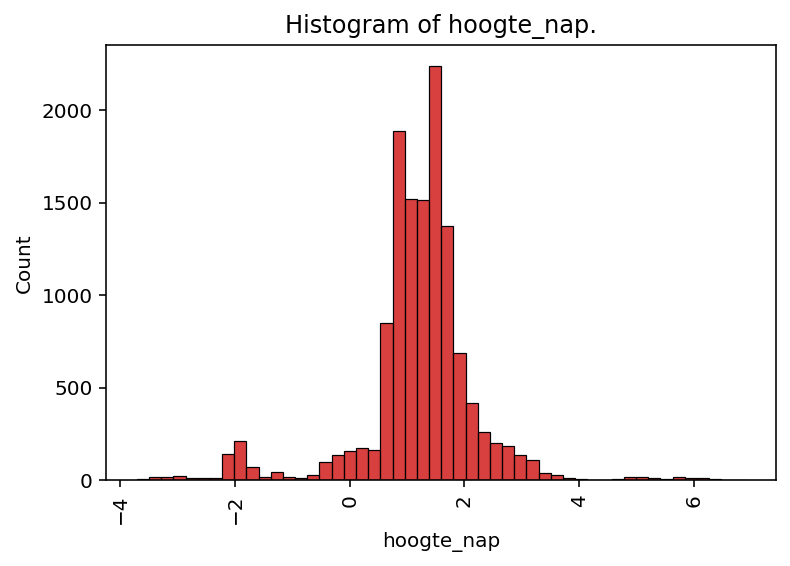

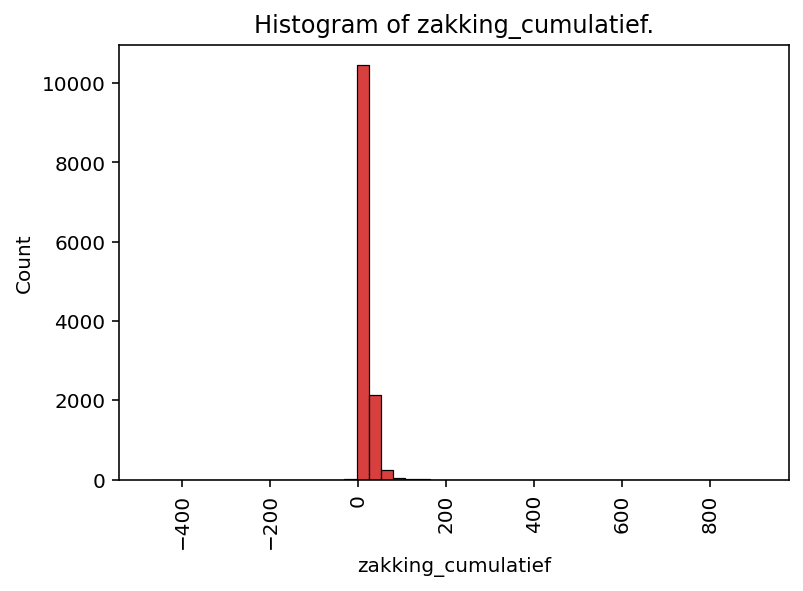

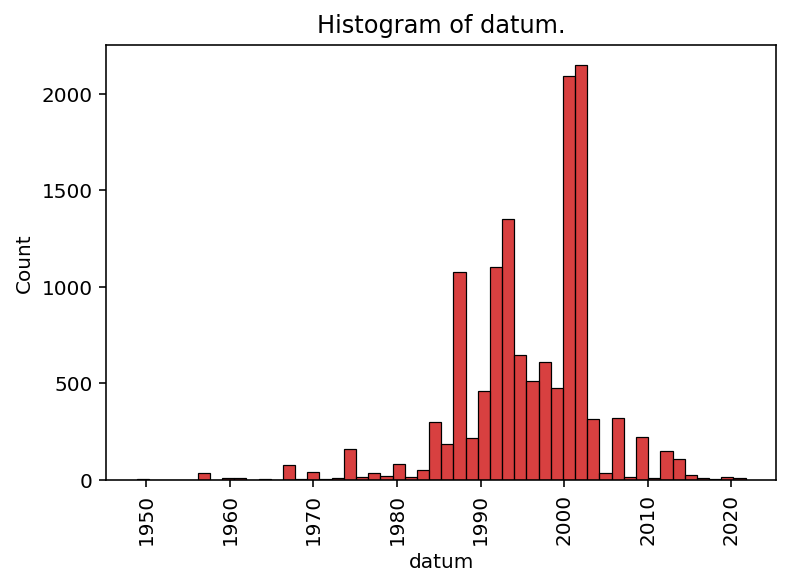

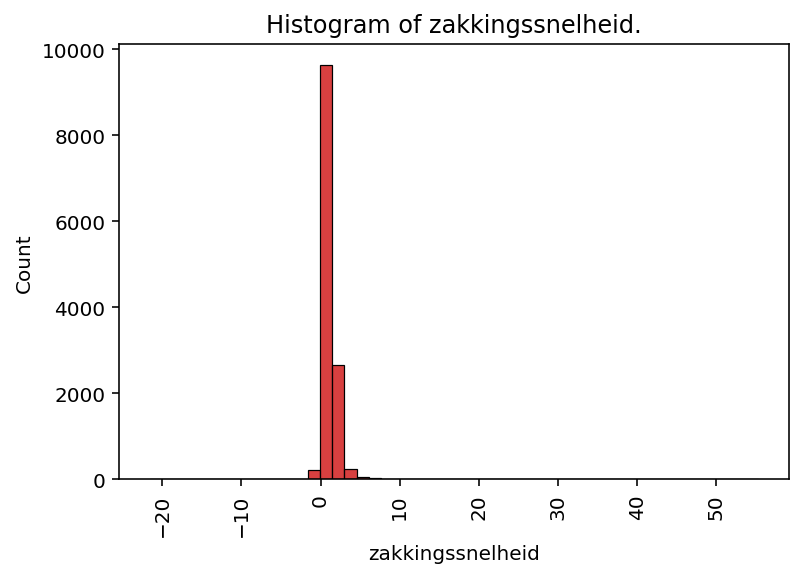

In [39]:
# iterate over columns
for col in df_meetbouten.columns:

    # skip the id and coordinates
    if col in ['meetboutidentificatie', 'x_coordinaat', 'y_coordinaat']:
        continue
        
    # plot histograms
    sns.histplot(df_meetbouten[col], bins=50, color=(0.8,0,0)) 
    plt.title(f'Histogram of {col}.')
    plt.xticks(rotation=90)
    plt.show()

The histogram of hoogte_nap seems reasonably normally distributed, with a bump around -2.
The value of zakking cumulatief is usually between 0 and 5.
There are sparse measurements before 1985. Most of the measurements were between 2000 and 2005. The data is sparse after 2010.
The value of zakkingssnelheid is usually between -1 and 5.

C:\Users\julia\anaconda3\lib\site-packages\seaborn\categorical.py:82: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


<AxesSubplot:>

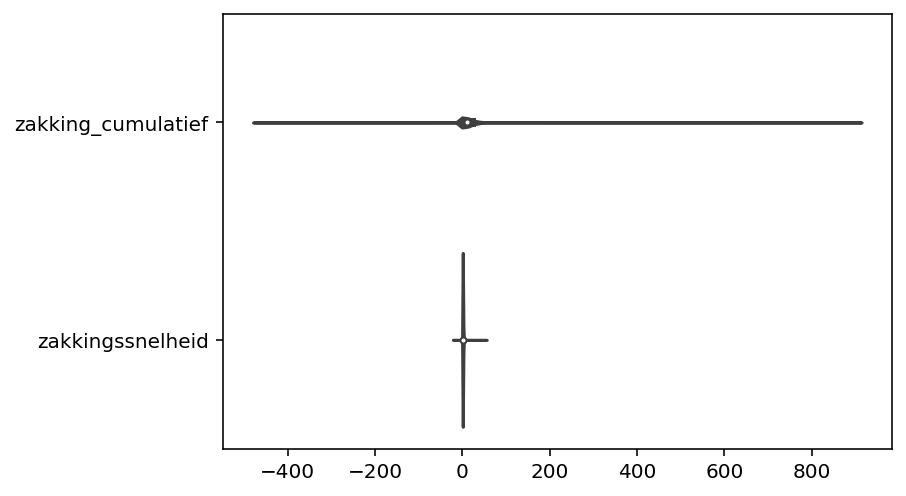

In [40]:
# draw violin plots
sns.violinplot(data=df_meetbouten[['zakking_cumulatief', 'zakkingssnelheid']], \
               orient='h')

The violin plot shows a big range of values for zakking cumulatief. For visualisation purposes, the plot is repeated for both variables with the range (-1, 20) below. It shows a median value of 6 for zakking_cumulatief and 1 for zakkingssnelheid. The values near zero are most common.

C:\Users\julia\anaconda3\lib\site-packages\seaborn\categorical.py:82: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  plot_data = [np.asarray(s, float) for k, s in iter_data]


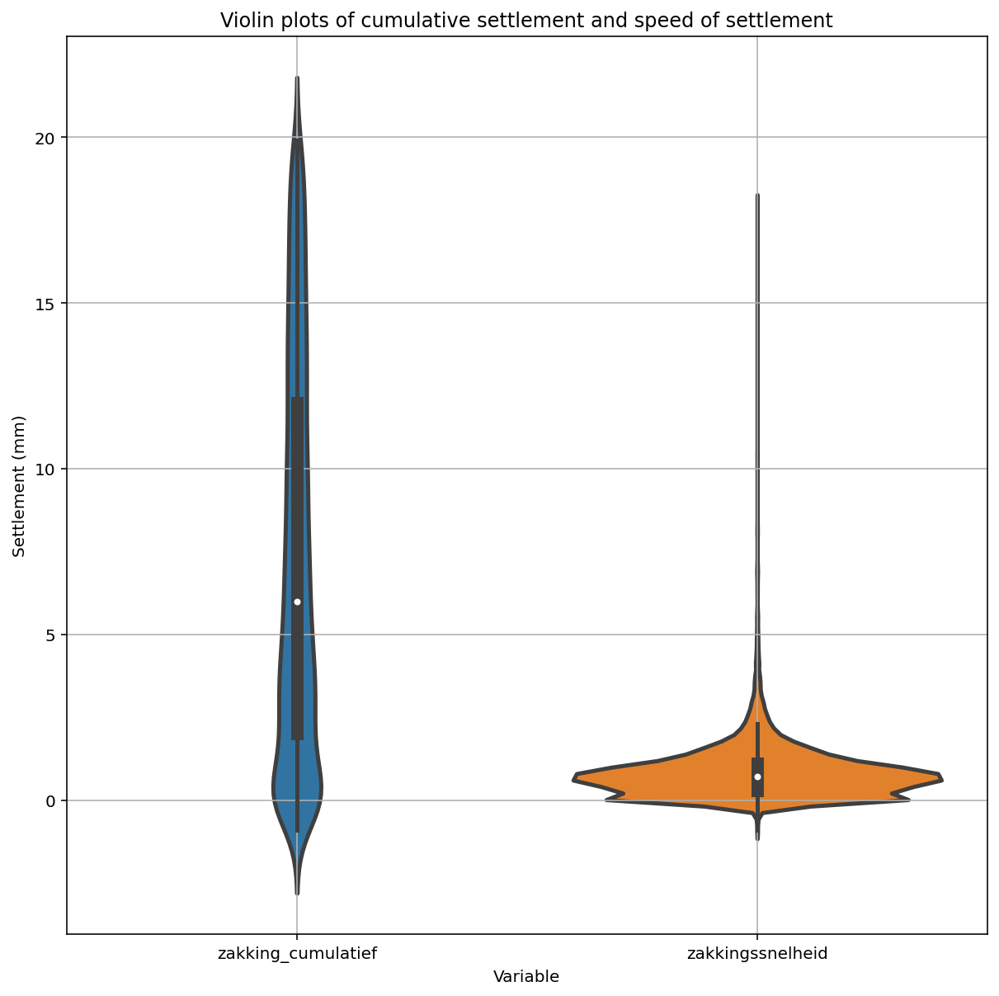

In [41]:
fig, ax = plt.subplots(figsize=(10,10))
df_mb_violin = df_meetbouten[['zakking_cumulatief', 'zakkingssnelheid']]

# only consider values between -1 and 20 for visualisation purposes
df_mb_violin = df_mb_violin[(df_mb_violin['zakking_cumulatief'] < 20) &
                            (df_mb_violin['zakking_cumulatief'] > -1) &
                            (df_mb_violin['zakkingssnelheid'] < 20) &
                            (df_mb_violin['zakkingssnelheid'] > -1)]

# plotting
sns.violinplot(data=df_mb_violin[['zakking_cumulatief', 'zakkingssnelheid']], \
               orient='v', ax=ax, linewidth=2.5)
plt.grid()
plt.title('Violin plots of cumulative settlement and speed of settlement')
plt.xlabel('Variable')
plt.ylabel('Settlement (mm)')
plt.show()

The following figure show the spread of the building tacheometry datapoints through the city. Most datapoints are outside the city centre.

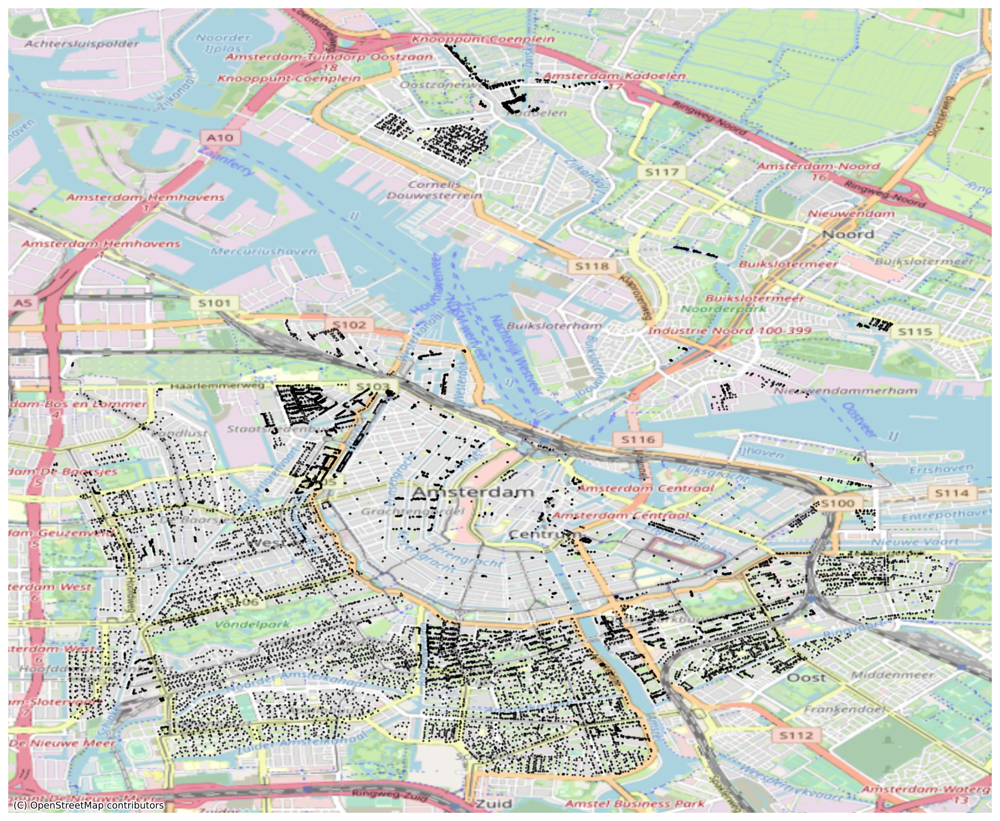

In [42]:
# create geo dataframe based on X and Y coordinates
gdf_meetbouten = gpd.GeoDataFrame(df_meetbouten, geometry=gpd.points_from_xy(\
                                df_meetbouten['x_coordinaat'], df_meetbouten['y_coordinaat']))

# add the correct coordinate system (Dutch RD)
gdf_meetbouten.crs = "EPSG:28992"

# project onto gps coordinate system for visualisation purposes
gdf_meetbouten = gdf_meetbouten.to_crs("EPSG:4326")

fig, ax = plt.subplots(figsize=(15,15))

# plot datapoints
gdf_meetbouten.plot(ax=ax, color='black', markersize=1, alpha=0.6)

# add background of city of Amsterdam
cx.add_basemap(ax=ax, source=cx.providers.OpenStreetMap.Mapnik, crs=gdf_meetbouten.crs)

# don't show the axes
ax.axis('off')
plt.show()

In [43]:
df_sat.shape

(10844, 9)

In [44]:
df_sat.isna().any()

id                 False
hor_velocity       False
ver_velocity       False
achter_velocity    False
tcd_hor            False
tcd_ver            False
tcd_achter         False
tcd_max            False
objectnumm         False
dtype: bool

In [45]:
df_sat.dtypes

id                   int64
hor_velocity       float64
ver_velocity       float64
achter_velocity    float64
tcd_hor            float64
tcd_ver            float64
tcd_achter         float64
tcd_max            float64
objectnumm          object
dtype: object

In [46]:
df_sat.describe()

,id,hor_velocity,ver_velocity,achter_velocity,tcd_hor,tcd_ver,tcd_achter,tcd_max
count,10844.000000,10844.000000,10844.000000,10844.000000,10844.000000,10844.000000,10844.000000,10844.000000
mean,5505.007470,7763.416856,6362.965382,2128.967778,0.023672,0.011608,0.026294,0.058192
std,3165.298498,4165.674014,4810.504992,4094.739299,0.247418,0.186759,0.259589,0.391997
min,1.000000,-1.068291,-36.452930,-58.103280,0.000000,0.000000,0.000000,0.000000
25%,2772.750000,9999.000000,-0.230778,-1.480906,0.000000,0.000000,0.000000,0.000000
50%,5508.500000,9999.000000,9999.000000,-0.632769,0.000000,0.000000,0.000000,0.000000
75%,8242.250000,9999.000000,9999.000000,0.209052,0.000000,0.000000,0.000000,0.000000
max,10978.000000,9999.000000,9999.000000,9999.000000,4.773115,4.784980,7.734266,7.734266


In [47]:
df_sub = df_sat[['hor_velocity', 'ver_velocity', 'achter_velocity', \
                 'tcd_hor', 'tcd_ver', 'tcd_achter', 'tcd_max']]
df_sub = df_sub.where((df_sub < 1000), np.nan)
df_sat[['hor_velocity', 'ver_velocity', 'achter_velocity', \
        'tcd_hor', 'tcd_ver', 'tcd_achter', 'tcd_max']] = df_sub

In [48]:
df_sat.isna().any()

id                 False
hor_velocity        True
ver_velocity        True
achter_velocity     True
tcd_hor            False
tcd_ver            False
tcd_achter         False
tcd_max            False
objectnumm         False
dtype: bool

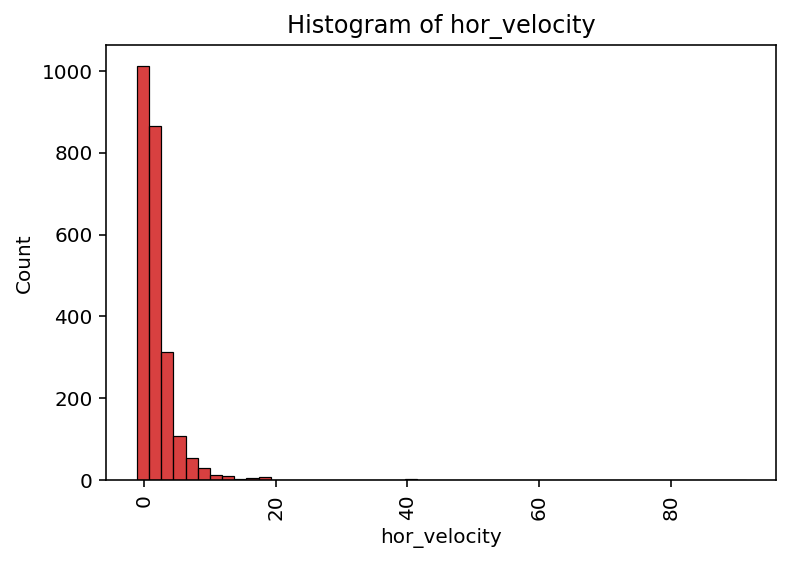

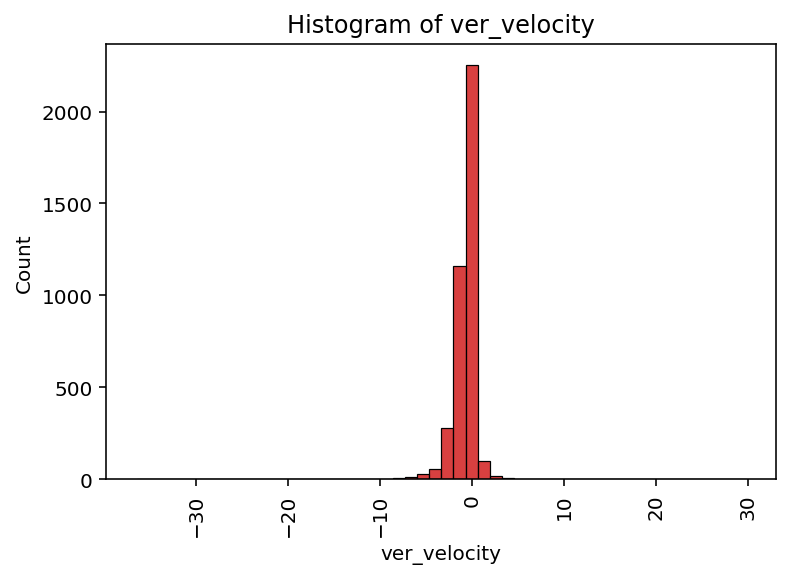

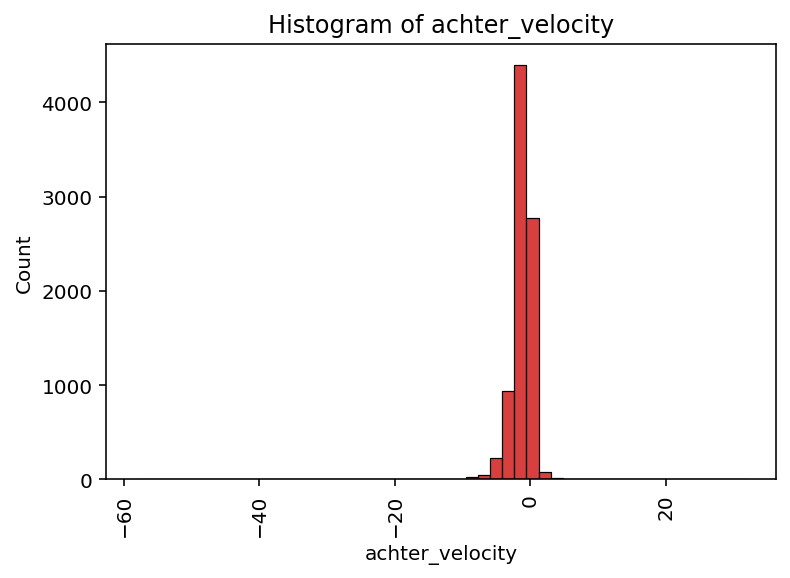

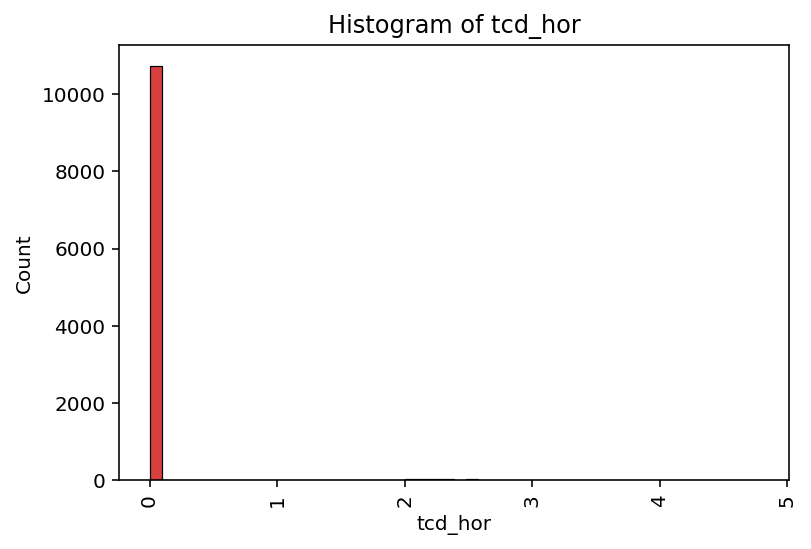

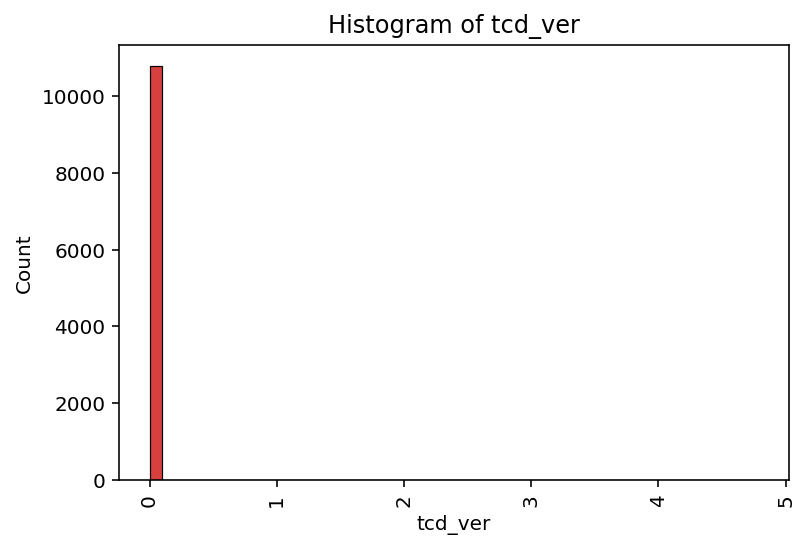

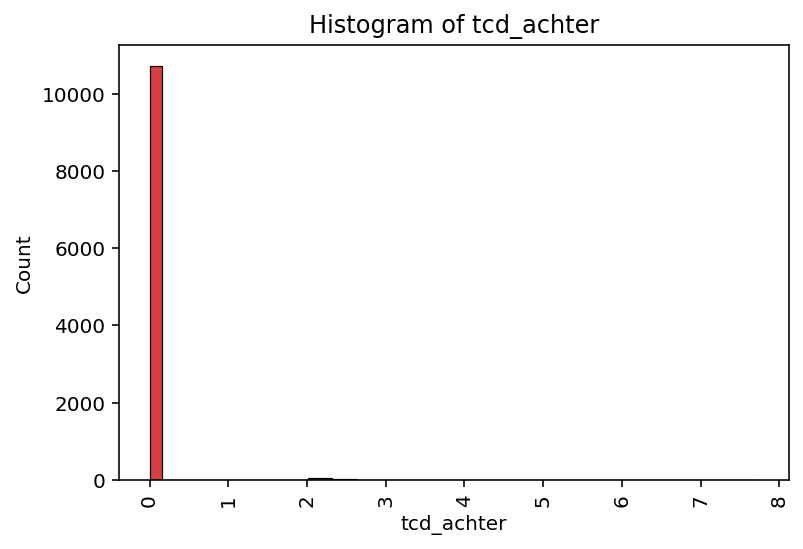

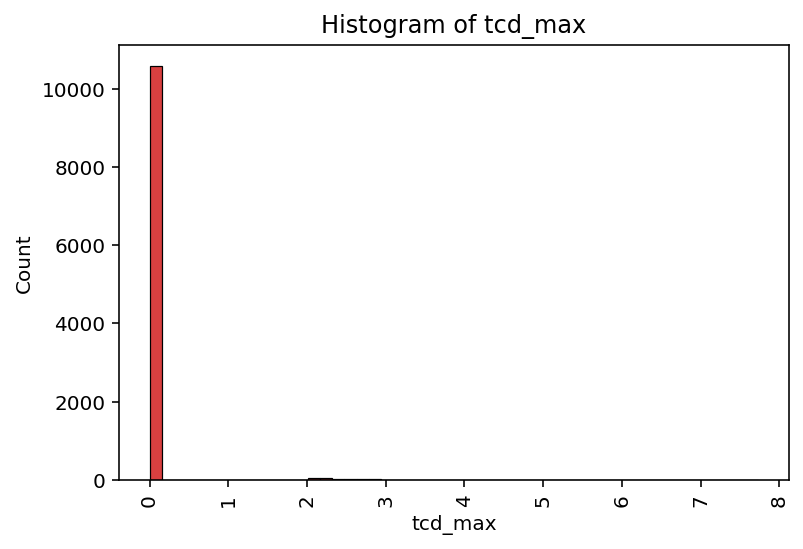

C:\Users\julia\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


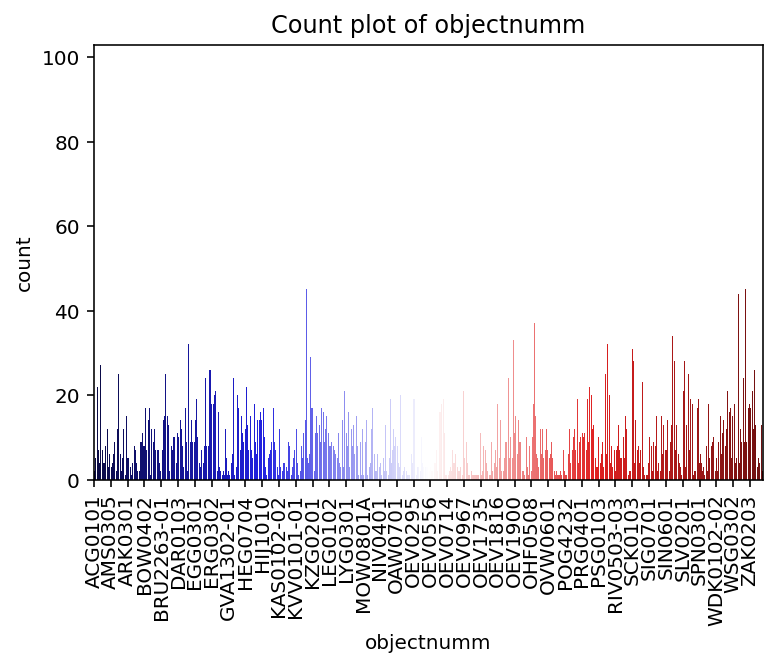

In [49]:
for col in df_sat:
    if col == 'id':
        continue
    if col == 'objectnumm':
        ids = sorted(df_sat[col].unique())
        x = [i for i in range(len(ids)) if i%30==0]
        sns.countplot(df_sat[col], order=ids, palette='seismic')
        plt.xticks(x, ids[::30])
        plt.title(f'Count plot of {col}')
    else:
        sns.histplot(df_sat[col], bins=50, color=(0.8,0,0))
        plt.title(f'Histogram of {col}')
    plt.xticks(rotation=90)
    plt.show()

The histograms show that the tcd variables are usually zero. The velocity variables are usually near zero. 
Out of the three directions, horizontal velocity has to highest values.

In [50]:
# get objectid's and corresponding coordinates
df_coords = pd.DataFrame()
df_coords['X_coordinate'] = df_tcmt.groupby('objectid')['X_coordinate'].mean()
df_coords['Y_coordinate'] = df_tcmt.groupby('objectid')['Y_coordinate'].mean()
df_coords = df_coords.reset_index()

In [51]:
# add coordinates to the satellite data
df_sat = df_coords.merge(df_sat, how='inner', left_on='objectid', right_on='objectnumm')

The following plot shows the spread of the satellite datapoints throughout the city. 

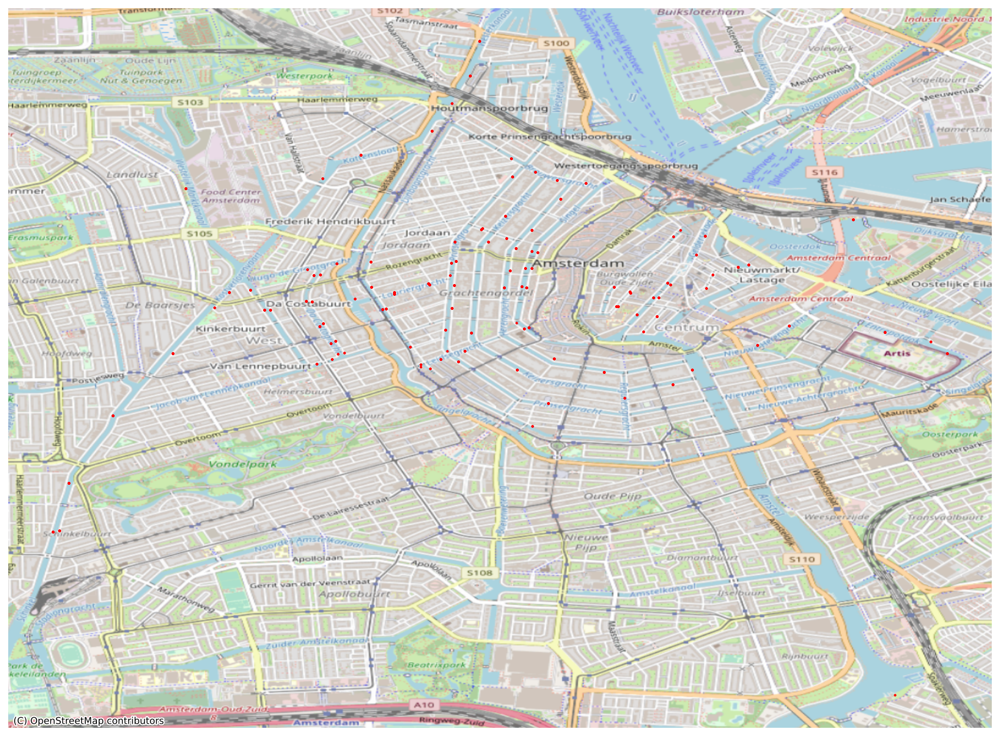

In [52]:
# create geo dataframe based on X and Y coordinates
gdf_sat = gpd.GeoDataFrame(df_sat, geometry=gpd.points_from_xy(df_sat['X_coordinate'], \
                                                               df_sat['Y_coordinate']))

# add the correct coordinate system (Dutch RD)
gdf_sat.crs = "EPSG:28992"

# project onto gps coordinate system for visualisation purposes
gdf_sat = gdf_sat.to_crs("EPSG:4326")

fig, ax = plt.subplots(figsize=(15,15))

# plot datapoints
gdf_sat.plot(ax=ax, color='red', markersize=1, alpha=1)

# add background of city of Amsterdam
cx.add_basemap(ax=ax, source=cx.providers.OpenStreetMap.Mapnik, crs=gdf_sat.crs)

# don't show the axes
ax.axis('off')
plt.show()

### Combination Analysis

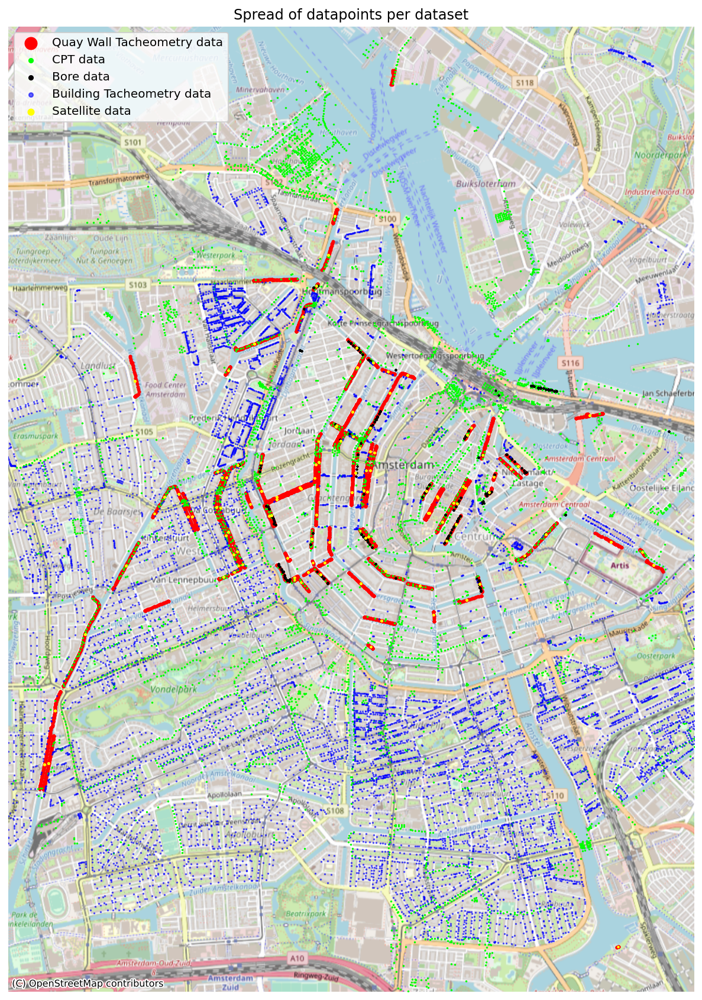

In [53]:
fig, ax = plt.subplots(figsize=(15,15))

# add datapoints and background to figure
gdf_tcmt.plot(ax=ax, color='red', markersize=4, label='Quay Wall Tacheometry data')
cx.add_basemap(ax=ax, source=cx.providers.OpenStreetMap.Mapnik, crs=gdf_tcmt.crs)
gdf_cpt_vis.plot(ax=ax, color='lime', markersize=0.5, alpha=1, label='CPT data')
gdf_bore.plot(ax=ax, color='black', markersize=0.5, alpha=1, label= 'Bore data')
gdf_meetbouten.plot(ax=ax, color='blue', markersize=0.5, alpha=0.6, label='Building Tacheometry data')
gdf_sat.plot(ax=ax, color='yellow', markersize=1, alpha=1, label='Satellite data')

plt.legend(markerscale=5)
ax.axis('off')
plt.title('Spread of datapoints per dataset')
plt.show()

The figure above shows the spread of the datapoints from all the datasets throughout the city. Most important are the red points, indicating quay wall tacheometry data, as this is the target variable. The figure shows that some quay walls have data from all the datasets, but several quay walls only have data from one dataset.

In [54]:
# calculate sum of dX, dY, and dZ per quay segment
gdf_tcmt['X_sum'] = gdf_tcmt[[col for i, col in enumerate(gdf_tcmt.columns[3:-1]) \
                              if i%3 == 0]].sum(axis=1)
gdf_tcmt['Y_sum'] = gdf_tcmt[[col for i, col in enumerate(gdf_tcmt.columns[3:-1]) \
                              if i%3 == 1]].sum(axis=1)
gdf_tcmt['Z_sum'] = gdf_tcmt[[col for i, col in enumerate(gdf_tcmt.columns[3:-1]) \
                              if i%3 == 2]].sum(axis=1)
gdf_tcmt_sub = gdf_tcmt[['objectid', 'X_coordinate', 'Y_coordinate', \
                         'X_sum', 'Y_sum', 'Z_sum', 'geometry']]

In [55]:
# calculate mean value of subsidence per object
gdf_sat_sub = gdf_sat.groupby('objectnumm').mean(numeric_only=True).reset_index()

In [56]:
# calculate mean value of deformation per object
gdf_tcmt_sub = gdf_tcmt_sub.groupby('objectid').mean(numeric_only=True).reset_index()

In [57]:
gdf_sat_sub = gdf_sat_sub[['hor_velocity', 'ver_velocity', \
                           'achter_velocity', 'objectnumm']]

# join satellite and deformation data on object id
gdf_combined = gdf_tcmt_sub.merge(gdf_sat_sub, how='inner', \
                                  left_on='objectid', right_on='objectnumm')

<AxesSubplot:>

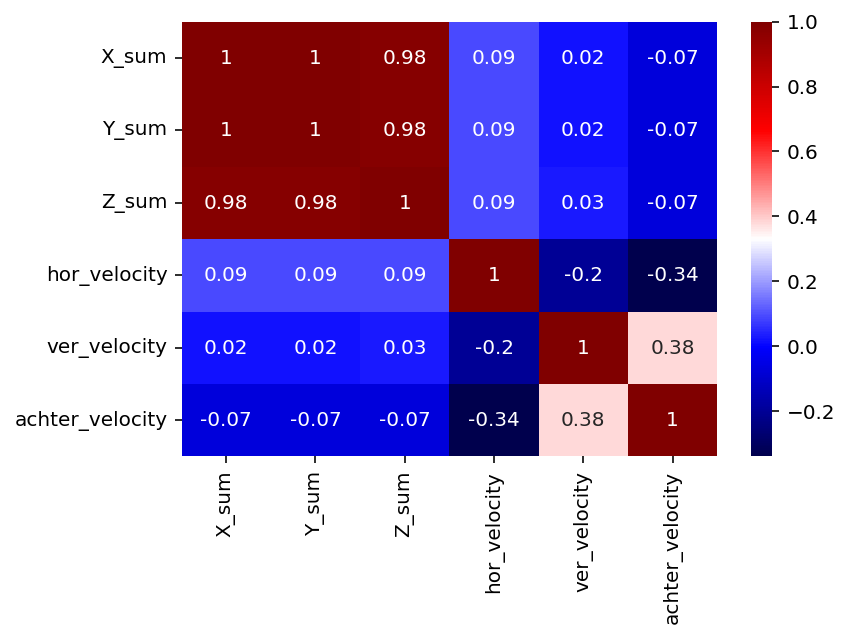

In [58]:
# calculate Pearson's R for correlation between variables
corr_tcmt_sat = gdf_combined[['X_sum', 'Y_sum', 'Z_sum', 'hor_velocity', \
                              'ver_velocity', 'achter_velocity']].corr().round(decimals=2)
sns.heatmap(corr_tcmt_sat, annot=True, cmap='seismic' )

The correlation matrix shows the correlations between the satellite and the quay wall tacheometry data. There do not seem any correlations between the data. It should be noted that this is the sum of the deformation of the quay walls, and a mean value of different segments of the quay walls. What will be worked with will be a time series of the tacheometry data, and hopefully a time series of the satellite data as well.

In [59]:
# group cpt data on location and calculate mean values of numeric variables per location
gdf_cpt['location'] = gdf_cpt[['easting', 'northing']].values.tolist()
gdf_cpt['location'] = gdf_cpt['location'].apply(tuple)
gdf_cpt_sub = gdf_cpt.groupby('location').mean(numeric_only=True).reset_index()

In [60]:
# create geodataframe again
gdf_cpt_sub = gpd.GeoDataFrame(gdf_cpt_sub, geometry=\
                               gpd.points_from_xy(gdf_cpt_sub['easting'], gdf_cpt_sub['northing']))

# project coordinates onto Dutch RD to get values in unit meters
gdf_cpt_sub.crs = "EPSG:28992"

# create geodataframe again
gdf_combined = gpd.GeoDataFrame(gdf_combined, geometry=\
                                gpd.points_from_xy(gdf_combined['X_coordinate'], gdf_combined['Y_coordinate']))

# project coordinates onto Dutch RD to get values in unit meters
gdf_combined.crs = "EPSG:28992"

In [61]:
# join previously merged data with cpt data based on the nearest location, only do so if within 10 meters.
gdf_combined1 = gpd.sjoin_nearest(gdf_combined, gdf_cpt_sub, how='inner', \
                                  max_distance=10, distance_col='DistanceTCMTCPT')

<AxesSubplot:>

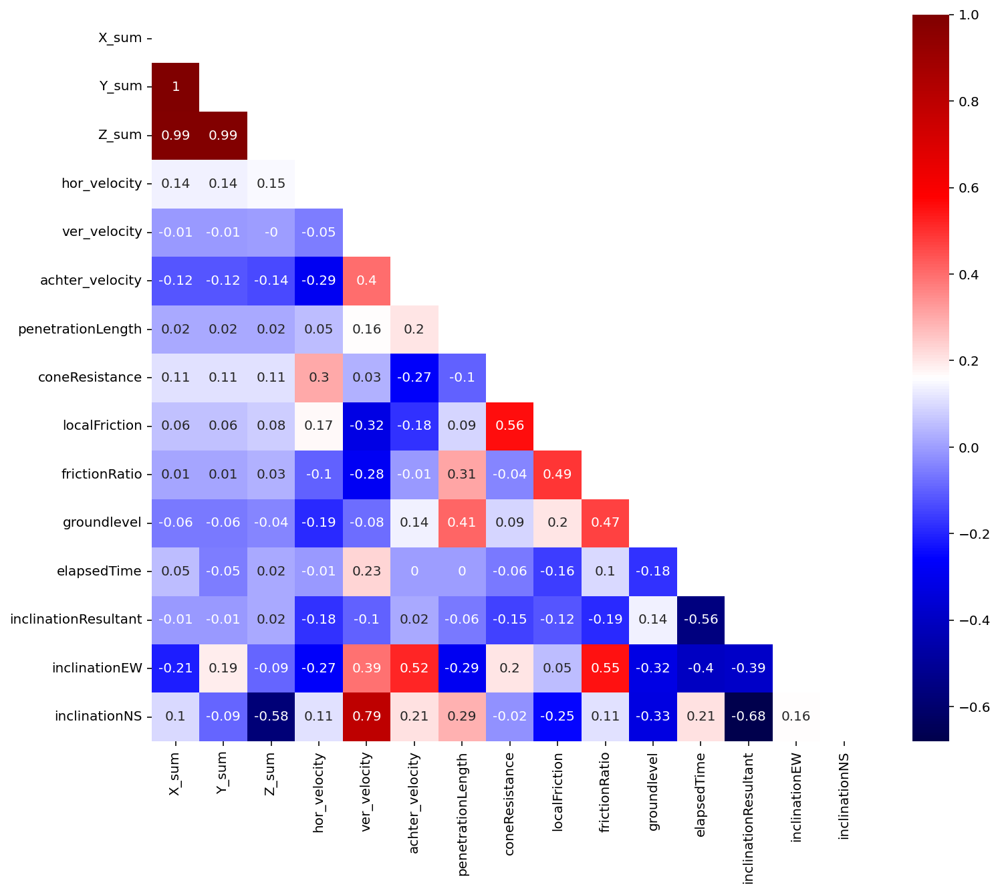

In [62]:
# calculate Pearson's R for correlation between indicated variables
corr1 = gdf_combined1[['X_sum', 'Y_sum', 'Z_sum', 'hor_velocity', 'ver_velocity', \
                       'achter_velocity', 'penetrationLength', 'coneResistance', \
                       'localFriction', 'frictionRatio', 'groundlevel', 'elapsedTime', \
                       'inclinationResultant', 'inclinationEW', \
                       'inclinationNS']].corr().round(decimals=2)

# mask top triangle of matrix
mask = np.triu(np.ones_like(corr1, dtype=bool))
plt.figure(figsize=(12,10))
sns.heatmap(corr1, annot=True, mask=mask, cmap="seismic")

The figure above displays the correlation matrix of variables of the quay wall tacheometry data, satellite data, and CPT data. The note of the previous correlation matrix is valid here as well. Anoter note: the tacheometry and satellite data were joined with the CPT data based on nearest location within 10 meters. The Pearson's R of inclination NS and vertical velocity is interesting. 